In [1]:
import numpy as np
import pandas as pd
import scipy.stats as stats
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline, FeatureUnion
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import pickle
from sklearn.metrics import f1_score,precision_score,recall_score,roc_auc_score,accuracy_score,roc_curve
from sklearn.metrics import brier_score_loss
from sklearn.metrics import log_loss

print('Numpy version:', np.__version__)
print('Pandas version:', pd.__version__)

Numpy version: 1.23.5
Pandas version: 1.3.4


In [2]:
import numba

In [3]:
numba.__version__

'0.56.4'

In [4]:
from numba.np.ufunc import _internal

In [5]:
import sklearn

In [6]:
sklearn.__version__

'1.1.3'

In [7]:
#conda install scikit-learn

In [8]:
#conda install scikit-learn-intelex
#pip install scipy

In [9]:
#from sklearn.base import BaseEstimator, TransformerMixin

In [10]:
#import pandas as pd

In [11]:
%matplotlib inline
plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = 8, 8
plt.rcParams['axes.labelsize'] = 22
plt.rcParams['axes.titlesize'] = 26
plt.rcParams['xtick.labelsize'] = 20
plt.rcParams['ytick.labelsize'] = 20
plt.rcParams['legend.fontsize'] = 20
plt.rcParams['savefig.dpi'] = 600 #图片像素
plt.rcParams['figure.dpi'] = 600 #分辨率

In [297]:
%matplotlib inline
plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = 12, 8
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['axes.titlesize'] = 18
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12
plt.rcParams['legend.fontsize'] = 12
plt.rcParams['savefig.dpi'] =1200 #图片像素
plt.rcParams['figure.dpi'] =1200 #分辨率

import dataset

In [12]:
star = pd.read_csv(r'F:/materi/11-LZ-PerCI and spine fractures/Figures and投稿/10.0 JMIR/Data/Data775.csv')
#data_train = pd.read_csv(r'F:/materi/11-LZ-PerCI and spine fractures/Figures and投稿/10.0 JMIR/Data/start0.7.csv')
#data_test = pd.read_csv(r'F:/materi/11-LZ-PerCI and spine fractures/Figures and投稿/10.0 JMIR/Data/starv0.3.csv')

In [13]:
#star.info()

In [14]:
from sklearn import datasets

In [15]:
star.Group.shape

(775,)

In [16]:
star.data = star.loc[:,["Pelvic.fractrue",
"Ventilation",
"Respiratory.failure",
"Pneumonia",
"Sepsis",
"Heart.rate",
"Respiratory.rate",
"Albumin",
"Glucose",
"Calcium",
"Hematocrit",
"OASIS",
"SAPSII",
"SOFA"]]

C:\Users\63276\AppData\Local\Temp\ipykernel_600\3036133198.py:1: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
  star.data = star.loc[:,["Pelvic.fractrue",


In [17]:
from imblearn.combine import SMOTETomek
smote_tomek = SMOTETomek(random_state=0)
X_res, y_res = smote_tomek.fit_resample(star.data, star.Group)

In [18]:
X_res.SOFA.value_counts()

2     206
3     189
4     187
1     164
5     162
6     109
7     103
8      62
0      54
9      44
10     20
11     13
12     10
13      2
14      2
15      2
16      1
Name: SOFA, dtype: int64

In [19]:
y_res.value_counts()

0    665
1    665
Name: Group, dtype: int64

In [23]:
X_train, X_test, y_train, y_test = train_test_split(X_res, y_res, test_size=0.2, stratify=y_res, random_state=0)

In [24]:
X_train.shape, y_train.shape

((1064, 14), (1064,))

In [25]:
X_test.shape, y_test.shape

((266, 14), (266,))

In [38]:
pd.set_option('display.max_columns', X_train.shape[1])
pd.set_option('max_colwidth', 1000)

In [39]:
X_train.head()

,Pelvic.fractrue,Ventilation,Respiratory.failure,Pneumonia,Sepsis,Heart.rate,Respiratory.rate,Albumin,Glucose,Calcium,Hematocrit,OASIS,SAPSII,SOFA
889,0,0,1,1,0,78.128160,14.077557,2.285827,135,8.900000,38.218008,33,27,3
437,0,1,0,0,0,69.000000,21.000000,2.800000,180,8.000000,33.700000,44,37,5
1246,0,1,0,1,0,107.227917,22.044954,2.370465,150,6.165970,31.372713,37,44,8
940,0,0,1,1,0,83.703824,14.098725,3.210297,231,8.309873,31.342465,25,36,3
391,0,0,0,0,0,94.000000,21.000000,3.454349,202,9.500000,35.400000,25,44,4


In [40]:
#data_train.info()

Data preprocessing piprlines
Prepare the data to a format that can be fit into scikit learn algorithms

Categorical variable encoder

In [41]:
categorical_vars = ["Pelvic.fractrue",
"Ventilation",
"Respiratory.failure",
"Pneumonia",
"Sepsis"]

In [42]:
X_train[categorical_vars].head()

,Pelvic.fractrue,Ventilation,Respiratory.failure,Pneumonia,Sepsis
889,0,0,1,1,0
437,0,1,0,0,0
1246,0,1,0,1,0
940,0,0,1,1,0
391,0,0,0,0,0


In [43]:
# to make a custom transformer to fit into a pipeline
class Vars_selector(BaseEstimator, TransformerMixin):
    '''Returns a subset of variables in a dataframe'''
    def __init__(self, var_names):
        '''var_names is a list of categorical variables names'''
        self.var_names = var_names
        
    def fit(self, X, y=None):
        return self
    
    def transform(self, X):
        '''returns a dataframe with selected variables'''
        return X[self.var_names]

In [44]:
class Cat_vars_encoder(BaseEstimator, TransformerMixin):
    def fit(self, X, y=None):
        return self
    
    def transform(self, X):
        '''X is a dataframe'''

        return X.values

Transform data in a pipeline

In [45]:
# categorical variables preprocessing
cat_vars_pipeline = Pipeline([
    ('selector', Vars_selector(categorical_vars)),
    ('encoder', Cat_vars_encoder())
])

For many machine learning algorithms, gradient descent is the preferred or even the only optimization method to learn the model parameters. Gradient descent is highly sensitive to feature scaling.

** Continuous vars **

In [46]:
continuous_vars = ["Heart.rate",
"Respiratory.rate",
"Albumin",
"Glucose",
"Calcium",
"Hematocrit",
"OASIS",
"SAPSII",
"SOFA"]

In [47]:
X_train[continuous_vars].describe()

,Heart.rate,Respiratory.rate,Albumin,Glucose,Calcium,Hematocrit,OASIS,SAPSII,SOFA
count,1064.000000,1064.000000,1064.000000,1064.000000,1064.000000,1064.000000,1064.000000,1064.000000,1064.000000
mean,93.947309,18.908047,2.953521,159.722744,8.086611,34.765153,32.759398,33.952068,4.136278
std,19.918563,5.804799,0.621856,102.808361,0.927767,5.414405,7.724100,13.018062,2.676197
min,41.000000,0.000000,1.053516,46.000000,4.300000,14.000000,13.000000,6.000000,0.000000
25%,78.000000,15.000000,2.549631,118.000000,7.600000,31.323273,28.000000,25.000000,2.000000
50%,92.000000,18.000000,2.904282,139.000000,8.200000,34.733731,32.000000,33.000000,4.000000
75%,107.620914,22.000000,3.349737,177.000000,8.700000,38.300000,38.000000,42.000000,6.000000
max,166.000000,42.000000,5.385000,2275.000000,12.500000,56.500000,57.000000,97.000000,16.000000


In [48]:
# continuous variables preprocessing
cont_vars_pipeline = Pipeline([
    ('selector', Vars_selector(continuous_vars)),
    ('standardizer', StandardScaler())
])

In [49]:
preproc_pipeline = FeatureUnion(transformer_list=[
    ('cat_pipeline', cat_vars_pipeline),
    ('cont_pipeline', cont_vars_pipeline)
])

In [50]:
data_train_X = pd.DataFrame(preproc_pipeline.fit_transform(X_train), 
                            columns= categorical_vars +continuous_vars)

In [51]:
data_train_X.head()

,Pelvic.fractrue,Ventilation,Respiratory.failure,Pneumonia,Sepsis,Heart.rate,Respiratory.rate,Albumin,Glucose,Calcium,Hematocrit,OASIS,SAPSII,SOFA
0,0.0,0.0,1.0,1.0,0.0,-0.794565,-0.832546,-1.074216,-0.240587,0.877129,0.638016,0.031164,-0.534284,-0.424787
1,0.0,1.0,0.0,0.0,0.0,-1.253054,0.360553,-0.246991,0.197326,-0.093398,-0.196818,1.455948,0.234241,0.322894
2,0.0,1.0,0.0,1.0,0.0,0.667059,0.540653,-0.938046,-0.094616,-2.071149,-0.626853,0.549267,0.772208,1.444415
3,0.0,0.0,1.0,1.0,0.0,-0.514510,-0.828897,0.413114,0.693628,0.240757,-0.632442,-1.005042,0.157389,-0.424787
4,0.0,0.0,0.0,0.0,0.0,0.002647,0.360553,0.805756,0.411417,1.524147,0.117307,-1.005042,0.772208,-0.050946


Fitting classifiers

In [52]:
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, VotingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import LinearSVC, SVC
from sklearn.model_selection import learning_curve, RandomizedSearchCV, GridSearchCV, cross_val_score
from sklearn.metrics import accuracy_score, roc_curve, roc_auc_score

In [53]:
y_train.value_counts()

1    532
0    532
Name: Group, dtype: int64

In [54]:
y_train

889     1
437     0
1246    1
940     1
391     0
       ..
1148    1
1049    1
659     1
457     0
84      0
Name: Group, Length: 1064, dtype: int64

This is a fairly balanced dataset(i.e., the number of positive and negative cases are roughly the same), and we'll use AUC as our metric to optimise the model performance.

Assessing learning curve using the model default settings
Tuning the model hyper-parameters are always difficult, so a good starting point is to see how the Scikit-learn default settings for the model performs, i.e., to see if it overfits or underfits, or is just right. This will give a good indication as to the direction of tuning.

In [55]:
def plot_learning_curves(model, X, y):
    train_sizes, train_scores, val_scores = learning_curve(model, X, y, cv=5, scoring='roc_auc',
                                                           random_state=42, n_jobs=-1)
    plt.plot(train_sizes, np.mean(train_scores, axis=1), "o-", label="training scores")
    plt.plot(train_sizes, np.mean(val_scores, axis=1), "o-", label="x-val scores")
    plt.legend(fontsize=14).get_frame().set_facecolor('white')
    plt.xlabel("Training set size")
    plt.ylabel("Area under Curve")
    plt.title('{} learning curve'.format(model.__class__.__name__))

# Compute and compare test metrics
Transform test data set

In [56]:
data_test_X = pd.DataFrame(preproc_pipeline.transform(X_test), # it's imperative not to do fit_transfomr again
                           columns=categorical_vars + continuous_vars)

In [57]:
data_test_X.shape

(266, 14)

In [58]:
y_test.value_counts()

0    133
1    133
Name: Group, dtype: int64

In [59]:
data_test_X.head()

,Pelvic.fractrue,Ventilation,Respiratory.failure,Pneumonia,Sepsis,Heart.rate,Respiratory.rate,Albumin,Glucose,Calcium,Hematocrit,OASIS,SAPSII,SOFA
0,0.0,0.0,0.0,0.0,0.0,0.002647,1.567019,-0.890529,-0.016765,1.739820,0.320564,1.196896,1.233323,1.444415
1,0.0,0.0,0.0,1.0,0.0,0.021055,-0.504638,1.551550,0.002698,0.705269,0.496424,-1.005042,-1.533366,-1.172467
2,0.0,0.0,0.0,0.0,0.0,0.304015,0.360553,0.788921,-0.581186,0.014438,-0.252252,-1.134568,-1.994481,-1.172467
3,0.0,0.0,0.0,1.0,0.0,1.704948,1.873312,-1.391575,-0.474141,0.241193,-0.720111,1.067371,0.849061,-0.050946
4,0.0,0.0,1.0,1.0,0.0,1.590214,0.345932,-0.420992,-0.289244,1.297885,0.458241,0.937845,1.233323,0.696734


In [60]:
def plot_roc_curve(fpr, tpr, auc, model=None):
    if model == None:
        title = None
    elif isinstance(model, str):
        title = model
    else:
        title = model.__class__.__name__
#    title = None if model == None else model.__class__.__name__
    plt.figure(figsize=(8, 8))
    plt.plot(fpr, tpr, linewidth=2, label='auc: {}'.format(auc))
    plt.plot([0, 1], [0, 1], 'k--')
    plt.axis([-.01, 1.01, -.01, 1.01])
    plt.xlabel('False Positive Rate', fontsize=14)
    plt.ylabel('True Positive Rate', fontsize=14)
    plt.legend(fontsize=14).get_frame().set_facecolor('white')
    plt.title('{} - ROC Curve'.format(title))

# Logistic Regression---网格搜索模型调参GridSearchCV

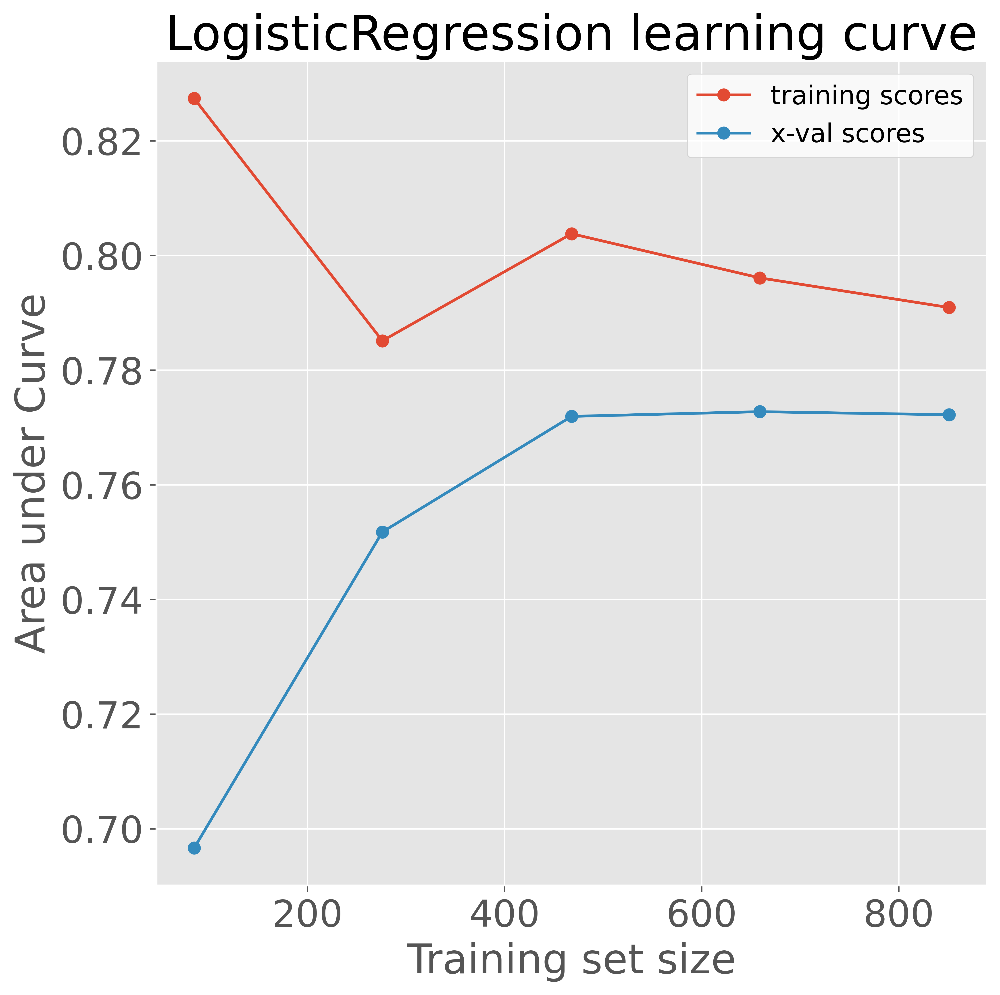

In [45]:
lr_clf = LogisticRegression(n_jobs = -1)
plot_learning_curves(lr_clf, data_train_X, y_train)

Let's see if we can squeeze some more performance out by optimising C

In [46]:
param_grid = {
        'C': [0.001, 0.01, 0.1, 1, 10, 100, 1000],
    }
lr_clf = LogisticRegression(random_state=42)
grid_search = GridSearchCV(lr_clf, param_grid=param_grid, return_train_score=True,
                                cv=5, scoring='roc_auc', n_jobs=-1)
grid_search.fit(data_train_X, y_train)

GridSearchCV(cv=5, estimator=LogisticRegression(random_state=42), n_jobs=-1,
             param_grid={'C': [0.001, 0.01, 0.1, 1, 10, 100, 1000]},
             return_train_score=True, scoring='roc_auc')

In [47]:
cv_rlt = grid_search.cv_results_
pd.DataFrame(sorted(list(zip(cv_rlt["mean_test_score"], cv_rlt['mean_train_score'], cv_rlt["params"])), 
                    key=lambda x: x[0], reverse=True), columns=['X-val scores', 'Train scores', 'Params'])

,X-val scores,Train scores,Params
0,0.772714,0.791532,{'C': 100}
1,0.772696,0.791529,{'C': 1000}
2,0.772643,0.791484,{'C': 10}
3,0.772189,0.790912,{'C': 1}
4,0.764346,0.782791,{'C': 0.1}
5,0.733460,0.749398,{'C': 0.01}
6,0.709770,0.717004,{'C': 0.001}


# Looks like C=100? is our best value.

下方with open,"wb",确实是保存了新的pkl模型文件，下一次使用该文件只需要直接调用即可

In [49]:
lr_clf = grid_search.best_estimator_
with open('F:/materi/11-LZ-PerCI and spine fractures/Figures and投稿/10.0 JMIR/Data/lr_clf_final_round.pkl', 'wb') as f:
    pickle.dump(lr_clf, f)

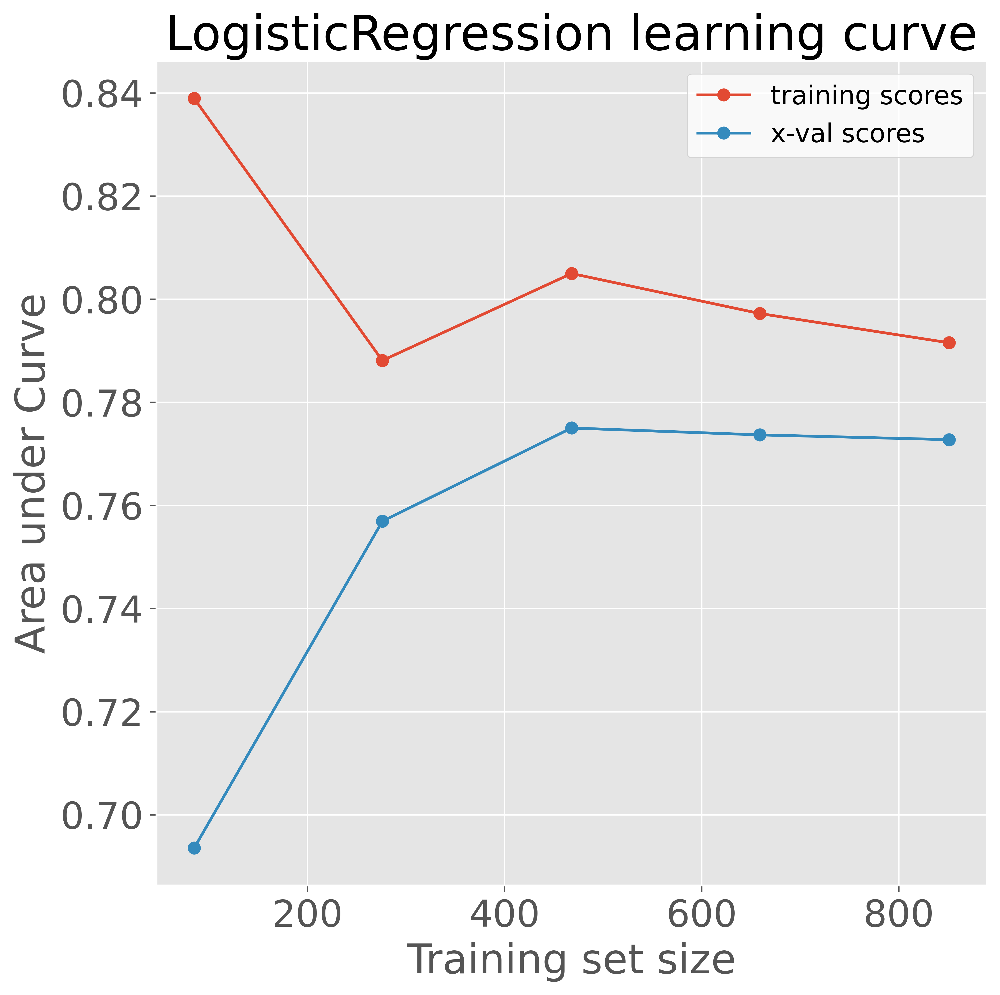

In [50]:
plot_learning_curves(lr_clf, data_train_X, y_train)

Looks like the logistic regression model would benefit from additional data.

# Logistic Regression model-ROC

In [51]:
# Import model and retrain
with open('F:/materi/11-LZ-PerCI and spine fractures/Figures and投稿/10.0 JMIR/Data/lr_clf_final_round.pkl', 'rb') as f:
    lr_clf = pickle.load(f)
lr_clf.fit(data_train_X, y_train)

LogisticRegression(C=100, random_state=42)

Accuracy scores

In [52]:
accu_lr = accuracy_score(y_test, lr_clf.predict(data_test_X))

In [53]:
round(accu_lr,3)

0.703

In [54]:
pd.crosstab(y_test, lr_clf.predict(data_test_X))

col_0,0,1
Group,,
0,91,42
1,37,96


In [55]:
pred_proba_lr = lr_clf.predict_proba(data_test_X)

In [56]:
lr_clf.predict(data_test_X)

array([1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1,
       1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1,
       0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1,
       0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1,
       0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0,
       1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1,
       1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1,
       1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0,
       1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0,
       0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0,
       0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1,
       0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1,
       1, 0], dtype=int64)

In [57]:
y_test

214     0
871     1
722     0
1160    1
1272    1
       ..
893     1
139     0
20      1
1308    1
98      0
Name: Group, Length: 266, dtype: int64

In [58]:
fpr, tpr, _ = roc_curve(y_test, pred_proba_lr[:, 1])
auc_lr = roc_auc_score(y_test, pred_proba_lr[:, 1])

In [59]:
lr_score = lr_clf.score(data_test_X, y_test)
lr_accuracy_score=accuracy_score(y_test,lr_clf.predict(data_test_X))
lr_preci_score=precision_score(y_test,lr_clf.predict(data_test_X))
lr_recall_score=recall_score(y_test,lr_clf.predict(data_test_X))
lr_f1_score=f1_score(y_test,lr_clf.predict(data_test_X))
lr_auc=roc_auc_score(y_test,pred_proba_lr[:, 1])
print('lr_accuracy_score: %f,lr_preci_score: %f,lr_recall_score: %f,lr_f1_score: %f,lr_auc: %f'
      %(lr_accuracy_score,lr_preci_score,lr_recall_score,lr_f1_score,lr_auc))

lr_accuracy_score: 0.703008,lr_preci_score: 0.695652,lr_recall_score: 0.721805,lr_f1_score: 0.708487,lr_auc: 0.752671


In [60]:
brier_score_loss(y_test, pred_proba_lr[:, 1])

0.20342186264696197

In [61]:
print('loss lr:', log_loss(y_test, pred_proba_lr[:, 1]))

loss lr: 0.600297189459309


In [62]:
round(auc_lr,3)

0.753

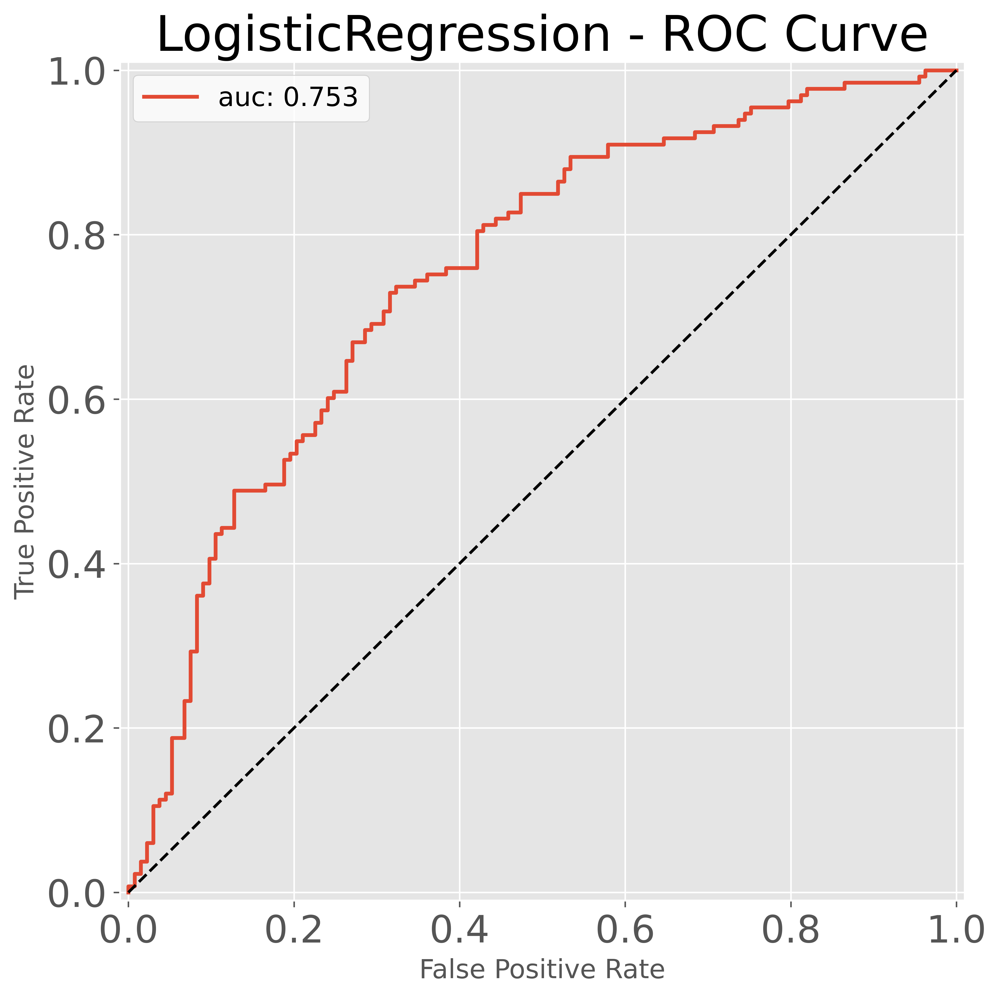

In [63]:
plot_roc_curve(fpr, tpr, round(auc_lr,3), lr_clf)

In [64]:
X_test['lr_pred_proba'] = pred_proba_lr[:, 1]

In [65]:
#X_test.to_csv('F:/materi/11-LZ-PerCI and spine fractures/Figures and投稿/10.0 JMIR/Data/test_set_with_predictions-lr.csv'.format(len(X_test)), index=False)

In [66]:
lr_his = X_test.join(y_test)

In [67]:
lr_his.to_csv('F:/materi/11-LZ-PerCI and spine fractures/Figures and投稿/10.0 JMIR/Data/test_set_with_predictions-lr.csv'.format(len(lr_his)), index=False)

In [68]:
lr_his.shape

(266, 16)

In [69]:
['#00468BFF','#ED0000FF','#42B540FF','#0099B4FF','#925E9FFF','#FDAF91FF','#AD002AFF','#1B1919FF']

['#00468BFF',
 '#ED0000FF',
 '#42B540FF',
 '#0099B4FF',
 '#925E9FFF',
 '#FDAF91FF',
 '#AD002AFF',
 '#1B1919FF']

In [70]:
def plot_class_breakdown_hist(df, var, var_name, plot_title, xlog=False, ylog=False, **histkwargs):
    df[var][df.Hospitalinfection == 0].hist(alpha=.5, label='Negative', color = "#00468BFF", **histkwargs)
    df[var][df.Hospitalinfection == 1].hist(alpha=.5, label='Positive', color = "#ED0000FF", **histkwargs)
    plt.xlabel(var_name)
    plt.title(plot_title)
    if xlog:
        plt.xscale('log')
    if ylog:
        plt.yscale('log')
    plt.ylim(ymax=600, ymin=0)
    plt.legend()
    plt.savefig(var_name + ' Class Breakdown.png');

In [72]:
#plot_class_breakdown_hist(lr_his, 'lr_pred_proba', var_name='Logistic Regression Risk', 
                          #plot_title='Logistic Regression Class Breakdown', bins=100)

In [73]:
def calculate_net_benefit_model(thresh_group, y_pred_score, y_label):
    net_benefit_model = np.array([])
    for thresh in thresh_group:
        y_pred_label = y_pred_score > thresh
        tn, fp, fn, tp = confusion_matrix(y_label, y_pred_label).ravel()
        n = len(y_label)
        net_benefit = (tp / n) - (fp / n) * (thresh / (1 - thresh))
        net_benefit_model = np.append(net_benefit_model, net_benefit)
    return net_benefit_model

In [74]:
def calculate_net_benefit_all(thresh_group, y_label):
    net_benefit_all = np.array([])
    tn, fp, fn, tp = confusion_matrix(y_label, y_label).ravel()
    total = tp + tn
    for thresh in thresh_group:
        net_benefit = (tp / total) - (tn / total) * (thresh / (1 - thresh))
        net_benefit_all = np.append(net_benefit_all, net_benefit)
    return net_benefit_all

In [75]:
def plot_DCA(ax, thresh_group, net_benefit_model, net_benefit_all):
    #Plot
    ax.plot(thresh_group, net_benefit_model, color = '#ED0000FF', label = 'Model')#crimson颜色也好看
    ax.plot(thresh_group, net_benefit_all, color = 'black',label = 'Treat all')
    ax.plot((0, 1), (0, 0), color = 'black', linestyle = ':', label = 'Treat none')

    #Fill，显示出模型较于treat all和treat none好的部分
    y2 = np.maximum(net_benefit_all, 0)
    y1 = np.maximum(net_benefit_model, y2)
    ax.fill_between(thresh_group, y1, y2, color = '#ED0000FF', alpha = 0.2)

    #Figure Configuration， 美化一下细节
    ax.set_xlim(0,1)
    #ax.set_ylim(net_benefit_model.min() - 0.15, net_benefit_model.max() + 0.15)#adjustify the y axis limitation
    ax.set_ylim(-0.1,0.6)
    ax.set_xlabel(
        xlabel = 'Threshold Probability')#fontdict= {'family': 'Times New Roman', 'fontsize': 15}设置字体
    ax.set_ylabel(
        ylabel = 'Net Benefit')
    ax.grid('major')
    ax.spines['right'].set_color((0.8, 0.8, 0.8))
    ax.spines['top'].set_color((0.8, 0.8, 0.8))
    ax.legend(loc = 'upper right')

    return ax

In [76]:
from sklearn.metrics import confusion_matrix

In [227]:
%matplotlib inline
plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = 9, 8
plt.rcParams['axes.labelsize'] = 22
plt.rcParams['axes.titlesize'] = 26
plt.rcParams['xtick.labelsize'] = 20
plt.rcParams['ytick.labelsize'] = 20
plt.rcParams['legend.fontsize'] = 20
plt.rcParams['savefig.dpi'] = 600 #图片像素
plt.rcParams['figure.dpi'] = 600 #分辨率

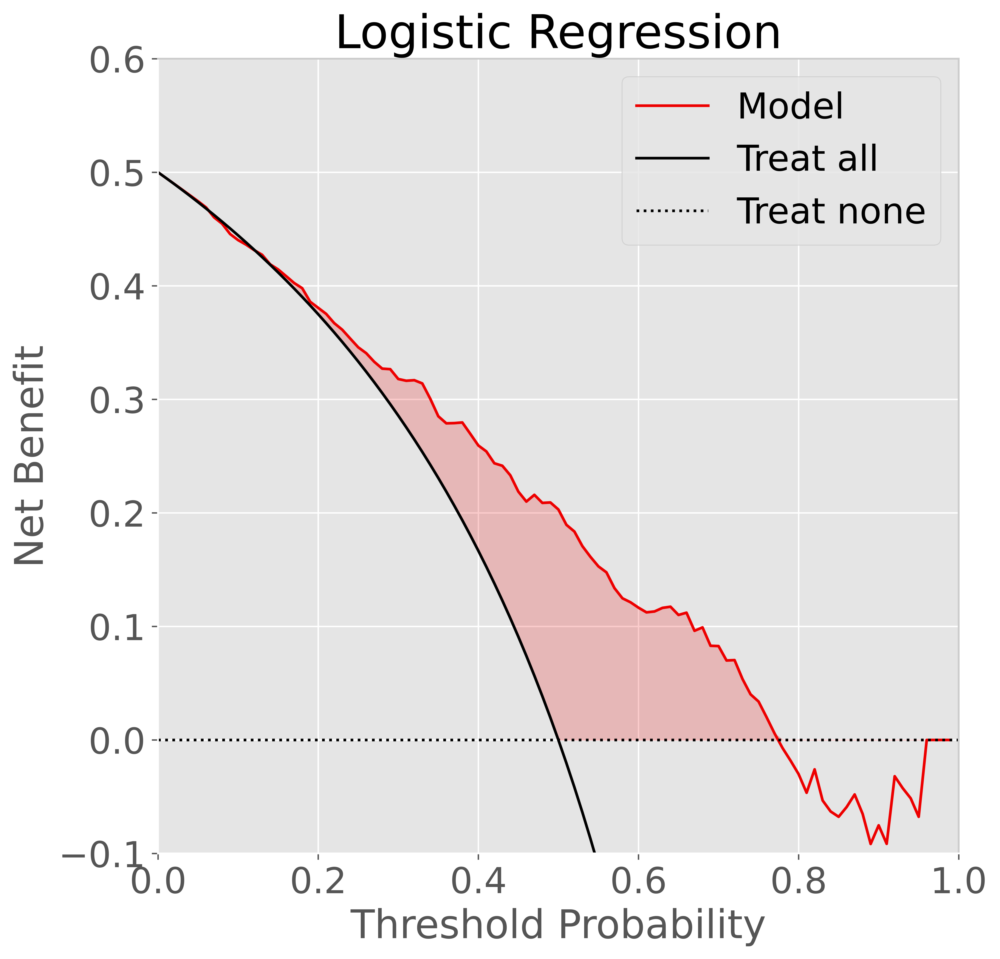

<Figure size 6000x6000 with 0 Axes>

In [77]:
thresh_group = np.arange(0,1,0.01)
net_benefit_model = calculate_net_benefit_model(thresh_group, pred_proba_lr[:, 1], y_test)
net_benefit_all = calculate_net_benefit_all(thresh_group, y_test)
fig, ax = plt.subplots()
ax = plot_DCA(ax, thresh_group, net_benefit_model, net_benefit_all)
# fig.savefig('fig1.png', dpi = 300)
plt.title("Logistic Regression")
plt.figure(figsize=(10, 10), dpi=600)
#plt.figure(dpi=300,figsize=(24,8))
plt.show()

ROC曲线+95%CI Bootstrap方法

In [78]:
def bootstrap_auc(y, pred, classes, bootstraps = 100, fold_size = 1000):
    statistics = np.zeros((len(classes), bootstraps))

    for c in range(len(classes)):
        df = pd.DataFrame(columns=['y', 'pred'])
        # df.
        df.loc[:, 'y'] = y
        df.loc[:, 'pred'] = pred
        df_pos = df[df.y == 1]
        df_neg = df[df.y == 0]
        prevalence = len(df_pos) / len(df)
        for i in range(bootstraps):
            pos_sample = df_pos.sample(n = int(fold_size * prevalence), replace=True)
            neg_sample = df_neg.sample(n = int(fold_size * (1-prevalence)), replace=True)

            y_sample = np.concatenate([pos_sample.y.values, neg_sample.y.values])
            pred_sample = np.concatenate([pos_sample.pred.values, neg_sample.pred.values])
            score = roc_auc_score(y_sample, pred_sample)
            statistics[c][i] = score
    return statistics

In [79]:
y = y_test
scores_lr = pred_proba_lr[:, 1]
statistics_lr = bootstrap_auc(y,scores_lr,[0,1])
print("均值:",np.mean(statistics_lr,axis=1))
print("最大值:",np.max(statistics_lr,axis=1))
print("最小值:",np.min(statistics_lr,axis=1))

均值: [0.75078168 0.75292652]
最大值: [0.792564 0.779112]
最小值: [0.713696 0.71246 ]


ROC曲线+95%CI 方法2

In [88]:
from sklearn.datasets import load_breast_cancer
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import roc_curve, roc_auc_score
from scipy.stats import norm
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
from sklearn.metrics import roc_curve, roc_auc_score
#label是每个样本对应的真实标签(0或1)，pred_prob是模型输出的对每个样本的预测概率
FPR, TPR, _ = roc_curve(y, pred, pos_label = 1)
AUC = roc_auc_score(y, pred)

In [ ]:
from scipy.stats import norm
import numpy as np
def AUC_CI(auc, label, alpha = 0.05):
	label = np.array(label)#防止label不是array类型
	n1, n2 = np.sum(label == 1), np.sum(label == 0)
	q1 = auc / (2-auc)
	q2 = (2 * auc ** 2) / (1 + auc)
	se = np.sqrt((auc * (1 - auc) + (n1 - 1) * (q1 - auc ** 2) + (n2 -1) * (q2 - auc ** 2)) / (n1 * n2))
	confidence_level = 1 - alpha
	z_lower, z_upper = norm.interval(confidence_level)
	lowerb, upperb = auc + z_lower * se, auc + z_upper * se
	return (lowerb, upperb)

In [98]:
import matplotlib.pyplot as plt
def plot_AUC(ax, FPR, TPR, AUC, CI, label):
	label = '{}: {} ({}-{})'.format(str(label), round(AUC, 3), round(CI[0], 3), round(CI[1], 3))
	ax.plot(FPR, TPR, label = label)
	return ax

In [130]:
FPR_test, TPR_test, _ = roc_curve(y, pred, pos_label = 1)
AUC_test = roc_auc_score(y, pred)
CI_test = AUC_CI(AUC_test, y, 0.05)

In [133]:
AUC_test

0.827433628318584

In [132]:
CI_test

(0.7322617725208916, 0.9226054841162764)

In [ ]:
plt.style.use('ggplot')
fig, ax = plt.subplots()
#ax = plot_AUC(ax, FPR_train, TPR_train, AUC_train, CI_train, label = 'train')
ax = plot_AUC(ax, FPR_test, TPR_test, AUC_test, CI_test, label = 'test')
ax.plot((0, 1), (0, 1), ':', color = 'grey')
ax.set_xlim(-0.01, 1.01)
ax.set_ylim(-0.01, 1.01)
ax.set_aspect('equal')
ax.set_xlabel('False Positive Rate')
ax.set_ylabel('True Positive Rate')
ax.legend()
plt.show()

# XGboot

In [80]:
from xgboost.sklearn import XGBClassifier

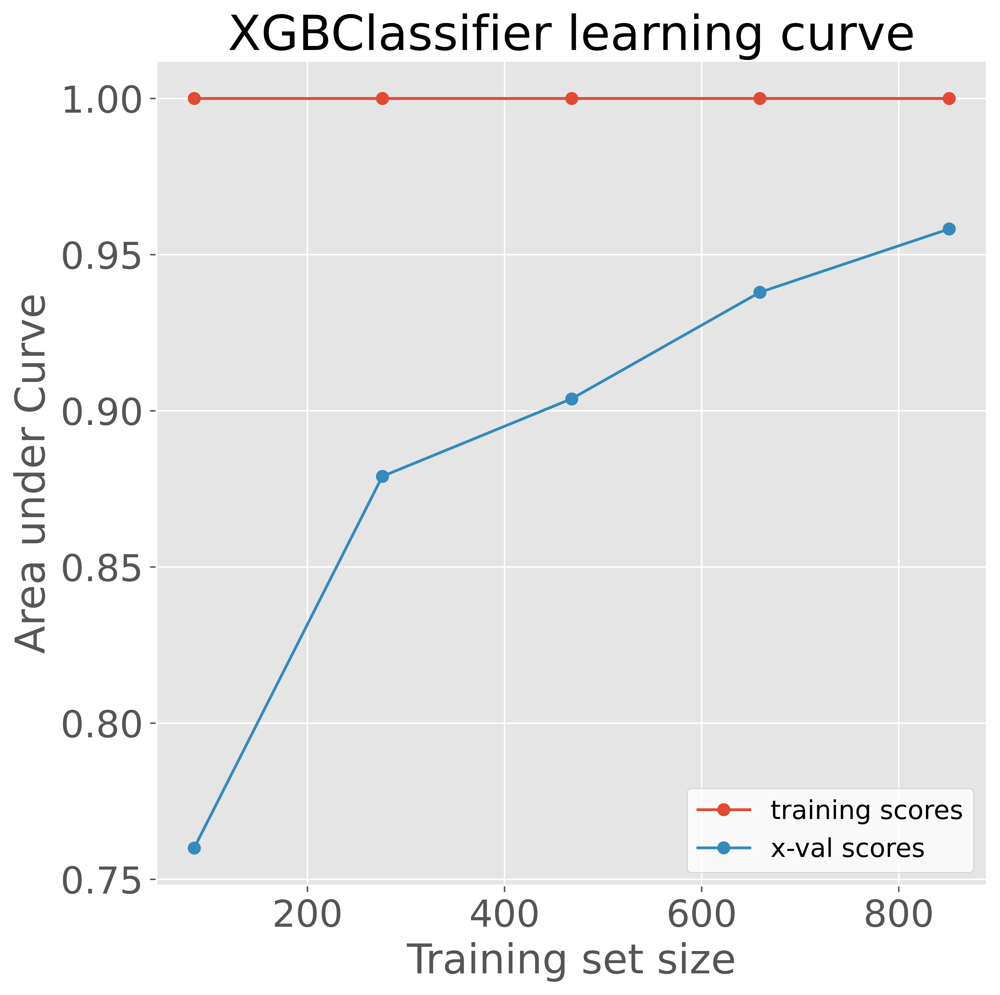

In [81]:
Xgbc_clf=XGBClassifier(random_state=42)  #Xgbc
plot_learning_curves(Xgbc_clf, data_train_X, y_train)

max_depth = 5 ：这应该在3-10之间。我从5开始，但你也可以选择不同的数字。4-6可以是很好的起点。
min_child_weight = 1 ：选择较小的值是因为它是高度不平衡的类问题，并且叶节点可以具有较小的大小组。
gamma = 0.1 ：也可以选择较小的值，如0.1-0.2来启动。无论如何，这将在以后进行调整。
subsample，colsample_bytree = 0.8：这是一个常用的使用起始值。典型值介于0.5-0.9之间。
scale_pos_weight = 1：由于高级别的不平衡。
colsample_bytree = 0.5,gamma=0.2

In [82]:
param_distribs = {
     'n_estimators': stats.randint(low=20, high=120),      
    'max_depth': stats.randint(low=1, high=100),
    'min_child_weight': stats.randint(low=1, high=100)
    }
Xgbc_clf=XGBClassifier(random_state=42,learning_rate=0.125,use_label_encoder=False)
Xgbc_search = RandomizedSearchCV(Xgbc_clf, param_distributions=param_distribs, return_train_score=True,
                                n_iter=100, cv=5, scoring='roc_auc', random_state=42, n_jobs=-1)
Xgbc_gs=Xgbc_search.fit(data_train_X, y_train)

C:\Users\63276\anaconda3\lib\site-packages\xgboost\sklearn.py:1395: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
C:\Users\63276\anaconda3\lib\site-packages\xgboost\sklearn.py:1395: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")
C:\Users\63276\anaconda3\lib\site-packages\xgboost\sklearn.py:1395: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")


In [83]:
print(Xgbc_gs.best_score_)

0.9534741468510761


In [84]:
print(Xgbc_gs.best_params_)

{'max_depth': 53, 'min_child_weight': 2, 'n_estimators': 107}


In [85]:
cv_rlt = Xgbc_search.cv_results_
pd.DataFrame(sorted(list(zip(cv_rlt["mean_test_score"], cv_rlt['mean_train_score'], cv_rlt["params"])), 
                    key=lambda x: x[0], reverse=True), columns=['X-val scores', 'Train scores', 'Params'])

,X-val scores,Train scores,Params
0,0.953474,1.000000,"{'max_depth': 53, 'min_child_weight': 2, 'n_estimators': 107}"
1,0.953279,1.000000,"{'max_depth': 53, 'min_child_weight': 2, 'n_estimators': 103}"
2,0.949284,1.000000,"{'max_depth': 97, 'min_child_weight': 1, 'n_estimators': 38}"
3,0.941918,0.999858,"{'max_depth': 24, 'min_child_weight': 3, 'n_estimators': 41}"
4,0.938618,0.999144,"{'max_depth': 33, 'min_child_weight': 5, 'n_estimators': 60}"
...,...,...,...
95,0.701003,0.726082,"{'max_depth': 80, 'min_child_weight': 93, 'n_estimators': 22}"
96,0.694400,0.717406,"{'max_depth': 37, 'min_child_weight': 97, 'n_estimators': 70}"
97,0.690173,0.717061,"{'max_depth': 52, 'min_child_weight': 96, 'n_estimators': 23}"
98,0.687929,0.713437,"{'max_depth': 62, 'min_child_weight': 97, 'n_estimators': 20}"


In [86]:
Xgbc_clf = Xgbc_search.best_estimator_
Xgbc_clf.fit(data_train_X, y_train)
with open('F:/materi/11-LZ-PerCI and spine fractures/Figures and投稿/10.0 JMIR/Data/Xgbc_clf_final_round.pkl', 'wb') as f:
    pickle.dump(Xgbc_clf, f)

In [87]:
Xgbc_clf

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.125, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=53, max_leaves=None,
              min_child_weight=2, missing=nan, monotone_constraints=None,
              n_estimators=107, n_jobs=None, num_parallel_tree=None,
              predictor=None, random_state=42, ...)

C:\Users\63276\anaconda3\lib\site-packages\xgboost\sklearn.py:1395: UserWarning: `use_label_encoder` is deprecated in 1.7.0.
  warnings.warn("`use_label_encoder` is deprecated in 1.7.0.")


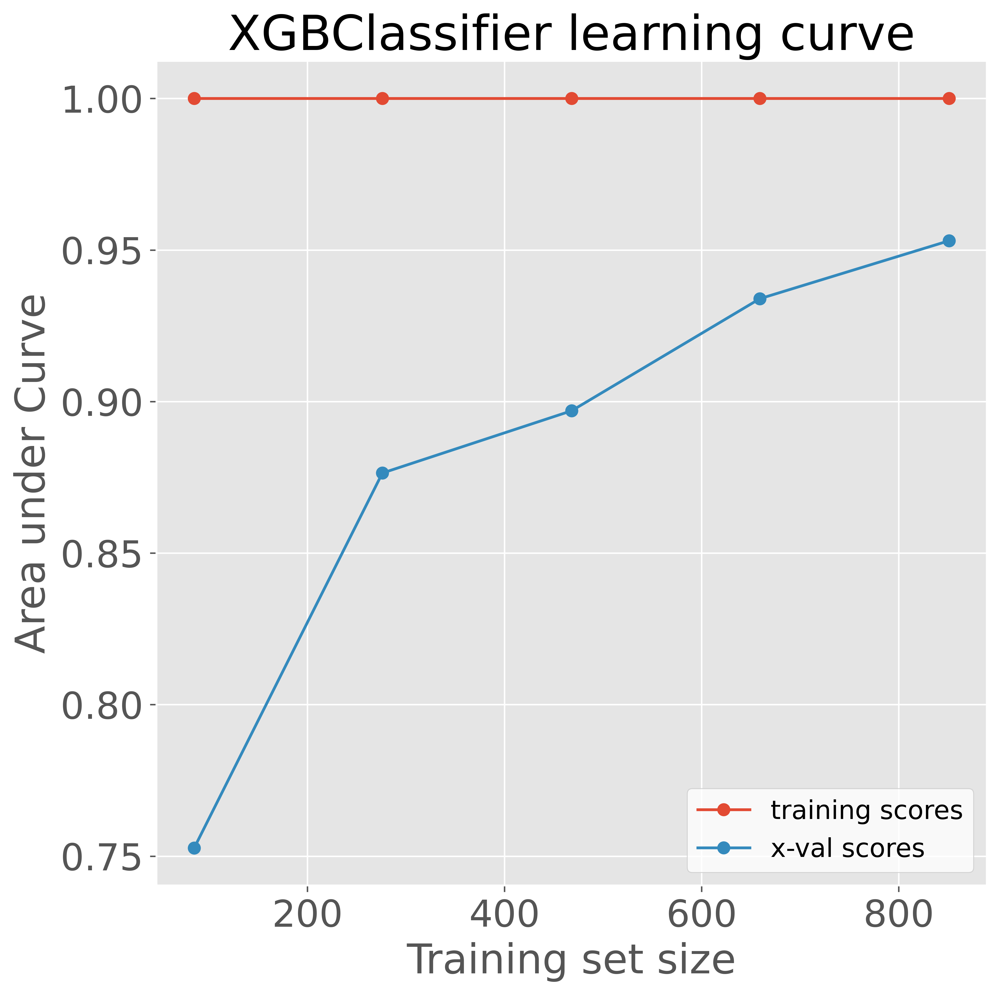

In [88]:
plot_learning_curves(Xgbc_clf, data_train_X, y_train)

# XGBoost-ROC

In [61]:
# Import model and retrain
with open('F:/materi/11-LZ-PerCI and spine fractures/Figures and投稿/10.0 JMIR/Data/Xgbc_clf_final_round.pkl', 'rb') as f:
    Xgbc_clf = pickle.load(f)
Xgbc_clf.fit(data_train_X, y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.125, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=53, max_leaves=None,
              min_child_weight=2, missing=nan, monotone_constraints=None,
              n_estimators=107, n_jobs=None, num_parallel_tree=None,
              predictor=None, random_state=42, ...)

In [62]:
accu_Xgbc = accuracy_score(y_test, Xgbc_clf.predict(data_test_X))
round(accu_Xgbc,3)

0.925

In [63]:
pd.crosstab(y_test, Xgbc_clf.predict(data_test_X))

col_0,0,1
Group,,
0,120,13
1,7,126


In [64]:
pred_proba_Xgbc = Xgbc_clf.predict_proba(data_test_X)

In [65]:
fpr, tpr, _ = roc_curve(y_test, pred_proba_Xgbc[:, 1])
auc_Xgbc = roc_auc_score(y_test, pred_proba_Xgbc[:, 1])
round(auc_Xgbc,3)

0.979

In [66]:
Xgbc_score = Xgbc_clf.score(data_test_X, y_test)
Xgbc_accuracy_score=accuracy_score(y_test,Xgbc_clf.predict(data_test_X))
Xgbc_preci_score=precision_score(y_test,Xgbc_clf.predict(data_test_X))
Xgbc_recall_score=recall_score(y_test,Xgbc_clf.predict(data_test_X))
Xgbc_f1_score=f1_score(y_test,Xgbc_clf.predict(data_test_X))
Xgbc_auc=roc_auc_score(y_test,pred_proba_Xgbc[:, 1])
print('Xgbc_accuracy_score: %f,Xgbc_preci_score: %f,Xgbc_recall_score: %f,Xgbc_f1_score: %f,Xgbc_auc: %f'
      %(Xgbc_accuracy_score,Xgbc_preci_score,Xgbc_recall_score,Xgbc_f1_score,Xgbc_auc))

Xgbc_accuracy_score: 0.924812,Xgbc_preci_score: 0.906475,Xgbc_recall_score: 0.947368,Xgbc_f1_score: 0.926471,Xgbc_auc: 0.978970


In [67]:
brier_score_loss(y_test, pred_proba_Xgbc[:, 1])

0.05612978866228668

In [68]:
print('loss Xgbc:', log_loss(y_test, pred_proba_Xgbc[:, 1]))

loss Xgbc: 0.19662056657414764


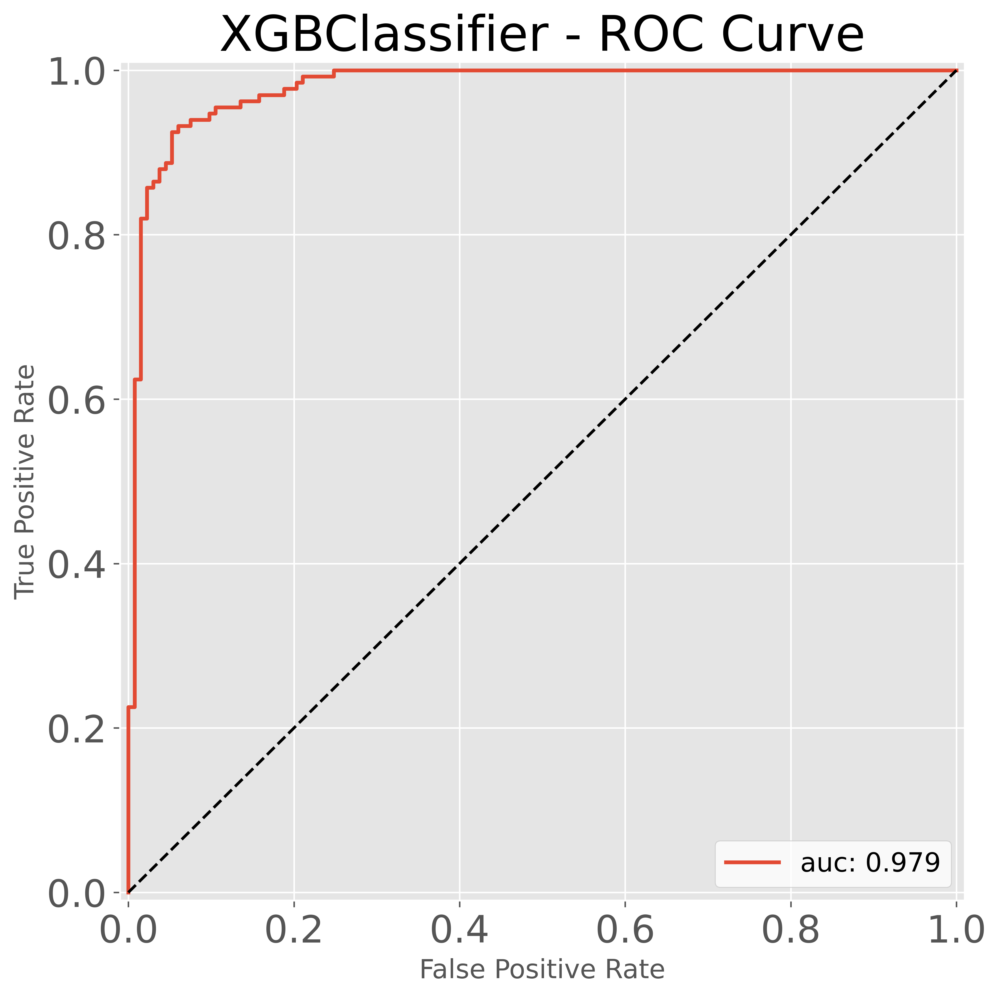

In [69]:
plot_roc_curve(fpr, tpr, round(auc_Xgbc,3), Xgbc_clf)

In [98]:
X_test['lr_pred_proba'] = pred_proba_Xgbc[:, 1]

In [99]:
xgbm_his = X_test.join(y_test)

In [100]:
xgbm_his.to_csv('F:/materi/11-LZ-PerCI and spine fractures/Figures and投稿/10.0 JMIR/Data/test_set_with_predictions-Xgbc.csv'.format(len(xgbm_his)), index=False)

In [101]:
y_Xgbc = y_test
scores_Xgbc = pred_proba_Xgbc[:, 1]
statistics_Xgbc = bootstrap_auc(y_Xgbc,scores_Xgbc,[0,1])
print("均值:",np.mean(statistics_Xgbc,axis=1))
print("最大值:",np.max(statistics_Xgbc,axis=1))
print("最小值:",np.min(statistics_Xgbc,axis=1))

均值: [0.97971772 0.97841384]
最大值: [0.991392 0.985068]
最小值: [0.970304 0.966228]


In [120]:
Xgbc_his = X_test.join(y_test)
Xgbc_his.shape

(44, 15)

In [102]:
#plot_class_breakdown_hist(Xgbc_his, 'lr_pred_proba', var_name='XGBoosting Risk', 
                          #plot_title='XGBoosting Class Breakdown', bins=100)

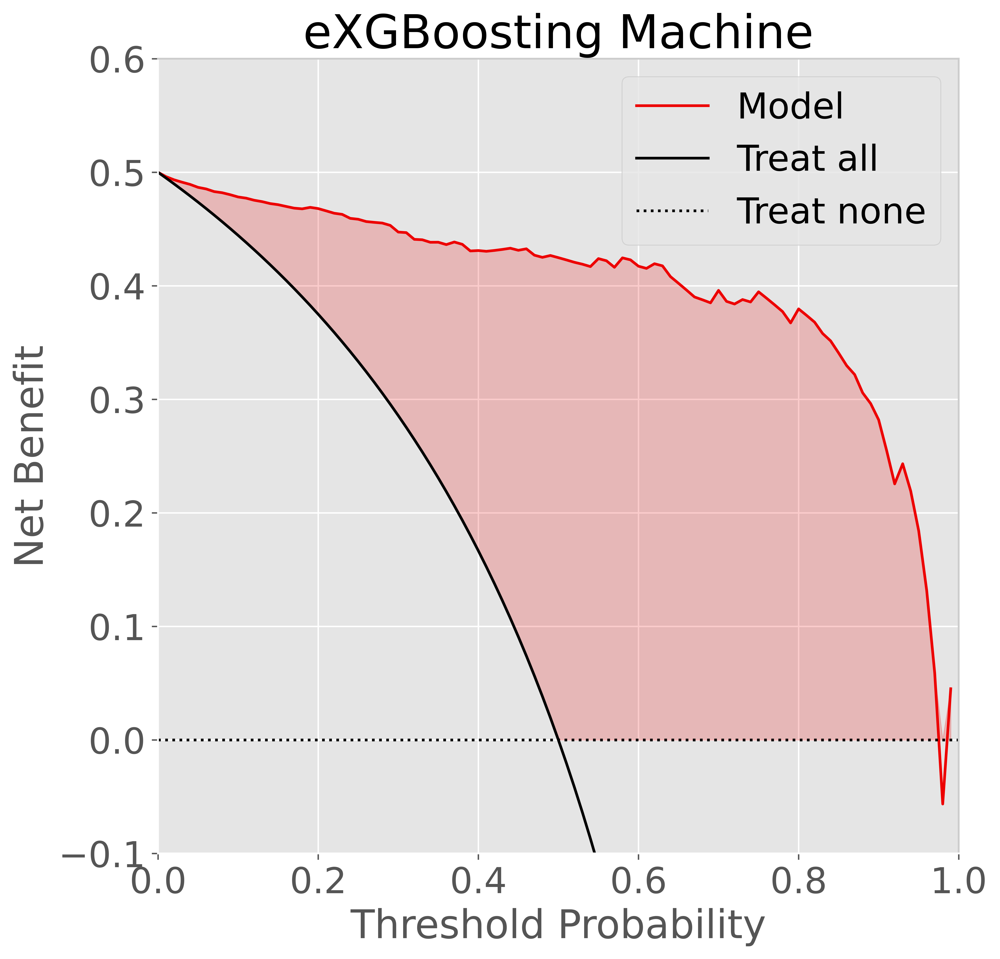

<Figure size 7200x2400 with 0 Axes>

In [103]:
thresh_group = np.arange(0,1,0.01)
net_benefit_model = calculate_net_benefit_model(thresh_group, pred_proba_Xgbc[:, 1], y_test)
net_benefit_all = calculate_net_benefit_all(thresh_group, y_test)
fig, ax = plt.subplots()
ax = plot_DCA(ax, thresh_group, net_benefit_model, net_benefit_all)
# fig.savefig('fig1.png', dpi = 300)
plt.title("eXGBoosting Machine")
#plt.figure(figsize=(10, 10), dpi=600)
plt.figure(dpi=300,figsize=(24,8))
plt.show()

In [70]:
import shap

In [72]:
shap.initjs()

In [73]:
model = Xgbc_clf.fit(data_train_X, y_train)

In [75]:
# explain the model's predictions using SHAP
# (same syntax works for LightGBM, CatBoost, scikit-learn, transformers, Spark, etc.)
explainer = shap.Explainer(model)
shap_values = explainer(data_test_X)###修改此处为不同数据集里面进行运算哦！

In [78]:
image = shap.plots.force(shap_values[1])

In [79]:
image

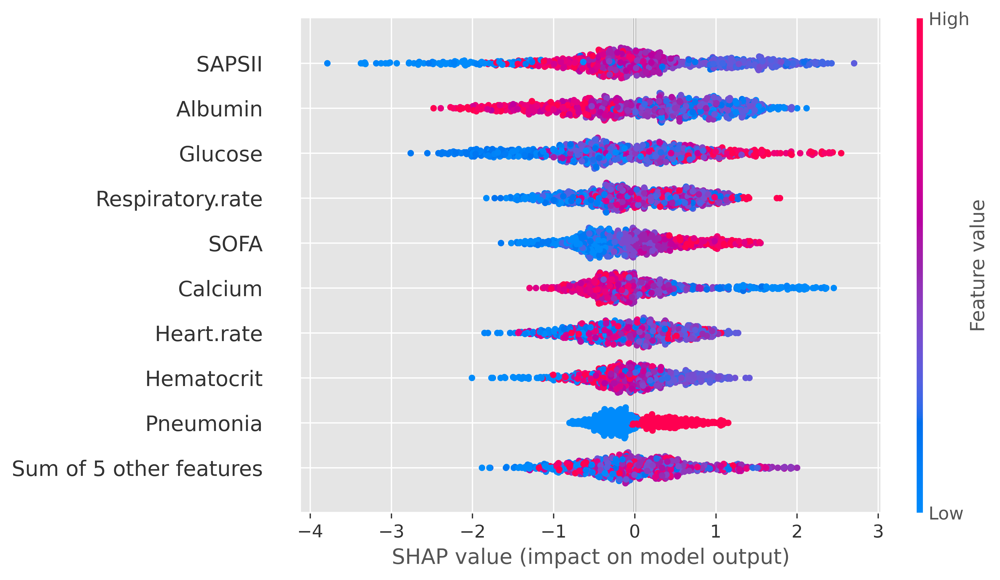

In [116]:
shap.plots.beeswarm(shap_values, max_display=10)###

In [45]:
import os
plt.tight_layout()
#plt.savefig('images.png')
plt.rcParams['savefig.dpi'] = 600 #图片像素
plt.rcParams['figure.dpi'] = 600 #分辨率
plt.figure(figsize=(8,10))
plt.show()

<Figure size 4800x4800 with 0 Axes>

<Figure size 4800x6000 with 0 Axes>

In [252]:
#shap.plots.beeswarm(shap_values, color="shap_red")

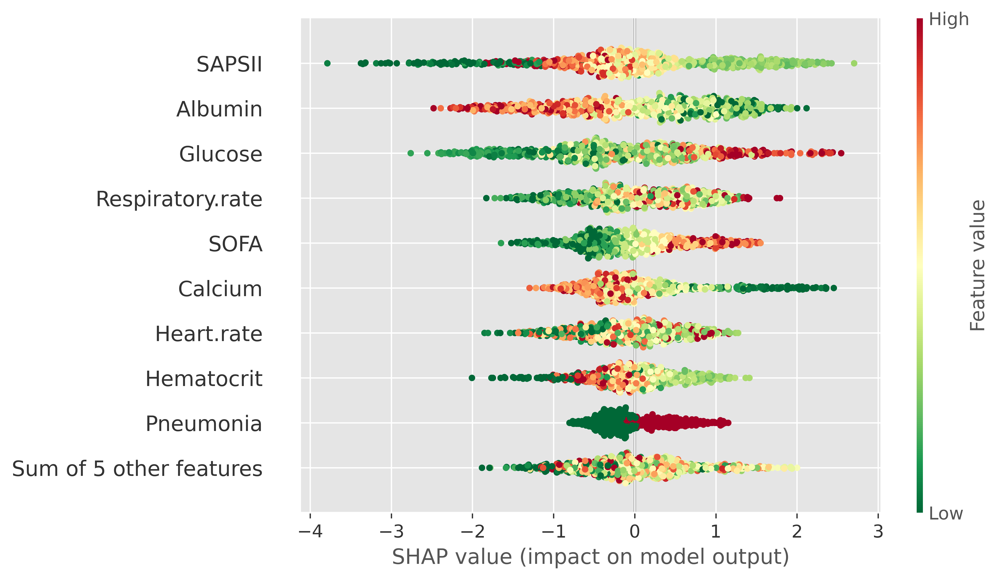

In [117]:
shap.plots.beeswarm(shap_values, max_display=10,color=plt.get_cmap("RdYlGn_r"))###

In [ ]:
ValueError: '#AD002AFF' is not a valid value for name; supported values are 'Accent', 'Accent_r', 'Blues', 'Blues_r', 'BrBG', 'BrBG_r', 'BuGn', 'BuGn_r', 'BuPu', 'BuPu_r', 'CMRmap', 'CMRmap_r', 'Dark2', 'Dark2_r', 'GnBu', 'GnBu_r', 'Greens', 'Greens_r', 'Greys', 'Greys_r', 'OrRd', 'OrRd_r', 'Oranges', 'Oranges_r', 'PRGn', 'PRGn_r', 'Paired', 'Paired_r', 'Pastel1', 'Pastel1_r', 'Pastel2', 'Pastel2_r', 'PiYG', 'PiYG_r', 'PuBu', 'PuBuGn', 'PuBuGn_r', 'PuBu_r', 'PuOr', 'PuOr_r', 'PuRd', 'PuRd_r', 'Purples', 'Purples_r', 'RdBu', 'RdBu_r', 'RdGy', 'RdGy_r', 'RdPu', 'RdPu_r', 'RdYlBu', 'RdYlBu_r', 'RdYlGn', 'RdYlGn_r', 'Reds', 'Reds_r', 'Set1', 'Set1_r', 'Set2', 'Set2_r', 'Set3', 'Set3_r', 'Spectral', 'Spectral_r', 'Wistia', 'Wistia_r', 'YlGn', 'YlGnBu', 'YlGnBu_r', 'YlGn_r', 'YlOrBr', 'YlOrBr_r', 'YlOrRd', 'YlOrRd_r', 'afmhot', 'afmhot_r', 'autumn', 'autumn_r', 'binary', 'binary_r', 'bone', 'bone_r', 'brg', 'brg_r', 'bwr', 'bwr_r', 'cividis', 'cividis_r', 'cool', 'cool_r', 'coolwarm', 'coolwarm_r', 'copper', 'copper_r', 'cubehelix', 'cubehelix_r', 'flag', 'flag_r', 'gist_earth', 'gist_earth_r', 'gist_gray', 'gist_gray_r', 'gist_heat', 'gist_heat_r', 'gist_ncar', 'gist_ncar_r', 'gist_rainbow', 'gist_rainbow_r', 'gist_stern', 'gist_stern_r', 'gist_yarg', 'gist_yarg_r', 'gnuplot', 'gnuplot2', 'gnuplot2_r', 'gnuplot_r', 'gray', 'gray_r', 'hot', 'hot_r', 'hsv', 'hsv_r', 'inferno', 'inferno_r', 'jet', 'jet_r', 'magma', 'magma_r', 'nipy_spectral', 'nipy_spectral_r', 'ocean', 'ocean_r', 'pink', 'pink_r', 'plasma', 'plasma_r', 'prism', 'prism_r', 'rainbow', 'rainbow_r', 'seismic', 'seismic_r', 'spring', 'spring_r', 'summer', 'summer_r', 'tab10', 'tab10_r', 'tab20', 'tab20_r', 'tab20b', 'tab20b_r', 'tab20c', 'tab20c_r', 'terrain', 'terrain_r', 'turbo', 'turbo_r', 'twilight', 'twilight_r', 'twilight_shifted', 'twilight_shifted_r', 'viridis', 'viridis_r', 'winter', 'winter_r'

In [ ]:
shap.plots.scatter(shap_values[:, "Age"], color=shap_values, show=False)
plt.tight_layout()
plt.show()

In [58]:
shap_values.mean(0)

.values =
array([-0.01490869, -0.01956581, -0.02182799, -0.08335485,  0.09568468,
        0.00185915,  0.00532065, -0.0004228 , -0.00048926,  0.00087903,
       -0.00117697,  0.0012979 , -0.00011239,  0.01889726,  0.0002098 ,
        0.        ,  0.00043724, -0.00732746,  0.00070088,  0.00051287],
      dtype=float32)

.base_values =
-0.007436118

.data =
array([7.06852096e+00, 1.55656133e+00, 1.44434387e+00, 2.05645161e+00,
       1.27989906e+00, 4.33399166e-03, 1.01382488e-01, 5.19804696e-02,
       5.62596006e-02, 4.27913101e-03, 4.16940970e-03, 6.11696291e-03,
       2.46872943e-04, 1.66282642e-01, 1.59095896e-03, 8.22909809e-05,
       2.27671714e-03, 6.60522273e-02, 3.34649989e-03, 1.52512618e-02])

In [49]:
shap_values

.values =
array([[-1.689217  , -0.32638156, -0.11575838, ..., -1.6339201 ,
         0.00442754,  0.01784878],
       [ 0.502147  ,  0.2598044 ,  0.28159377, ...,  0.06761301,
         0.0070602 ,  0.02052905],
       [-0.0585958 , -0.04890853,  0.01068864, ...,  0.01513926,
         0.003981  ,  0.00958324],
       ...,
       [ 0.36784104,  0.06191675, -0.11090717, ...,  0.01134764,
         0.00937736,  0.01517079],
       [-0.11854301,  0.170158  ,  0.02780815, ...,  0.0339652 ,
         0.00442213,  0.03709338],
       [ 0.52858937, -0.05437286,  0.09868255, ...,  0.04171662,
         0.00554309,  0.01525547]], dtype=float32)

.base_values =
array([-0.00743612, -0.00743612, -0.00743612, ..., -0.00743612,
       -0.00743612, -0.00743612], dtype=float32)

.data =
array([[6, 2, 2, ..., 1, 0, 0],
       [8, 1, 1, ..., 0, 0, 0],
       [7, 2, 1, ..., 0, 0, 0],
       ...,
       [8, 1, 2, ..., 0, 0, 0],
       [7, 1, 1, ..., 0, 0, 0],
       [8, 2, 1, ..., 0, 0, 0]], dtype=int64)

In [83]:
shap.plots.force(shap_values[0])

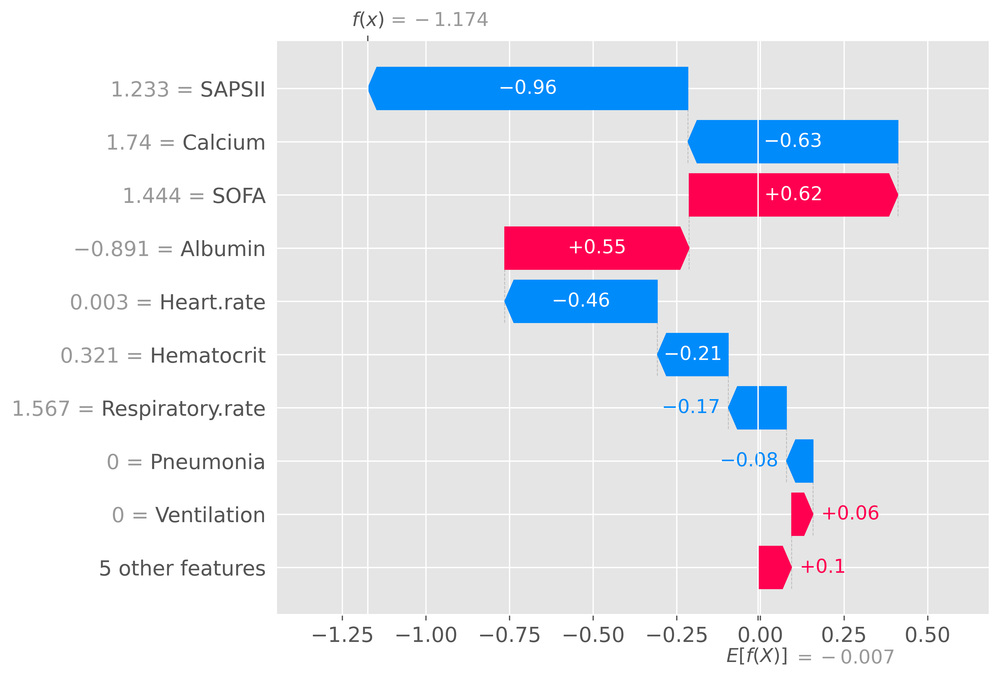

In [84]:
shap.plots.waterfall(shap_values[0])

In [85]:
shap.plots.force(shap_values[1])

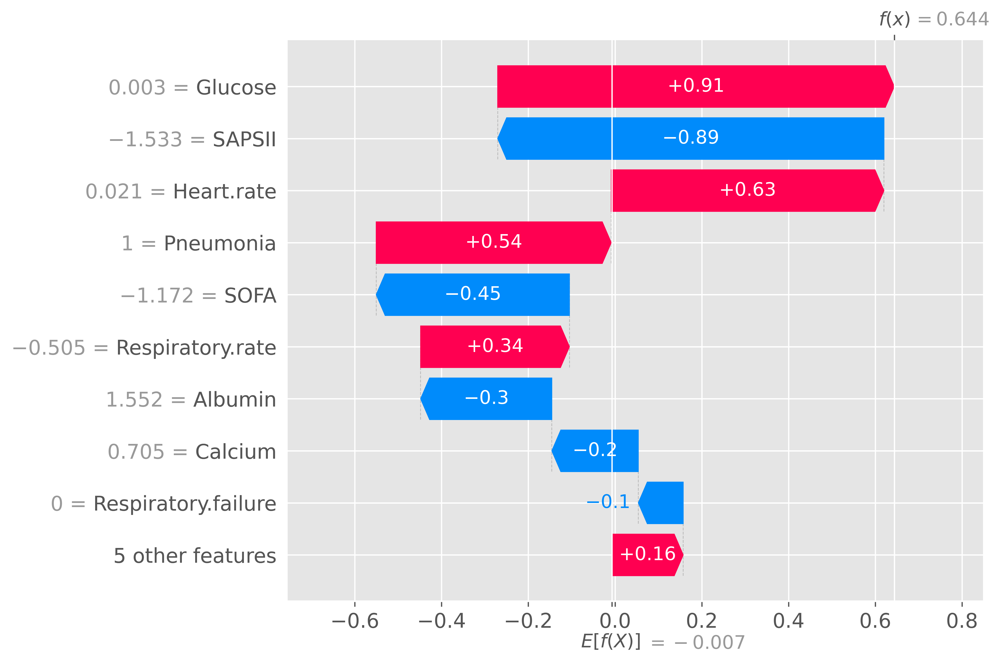

In [86]:
shap.plots.waterfall(shap_values[1])

In [87]:
shap.plots.force(shap_values[3])

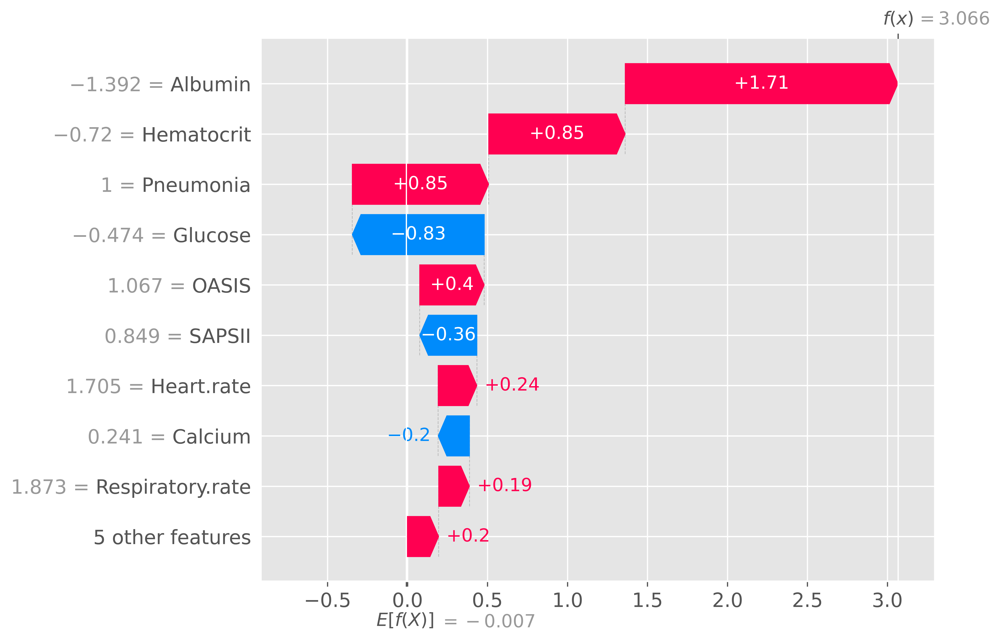

In [88]:
shap.plots.waterfall(shap_values[3])

In [415]:
from xgboost import plot_importance
from matplotlib import pyplot

In [164]:
import os
plt.tight_layout()
#plt.savefig('images.png')
plt.rcParams['savefig.dpi'] = 1200 #图片像素
plt.rcParams['figure.dpi'] = 1200 #分辨率
plt.figure(figsize=(8,10))
plt.show()

<Figure size 14400x9600 with 0 Axes>

<Figure size 9600x12000 with 0 Axes>

In [163]:
import matplotlib.pyplot as plt
from matplotlib import rcParams

config = {
            "font.family": 'serif',
            "font.size": 12,
            "mathtext.fontset": 'stix',
            "font.serif": ['Arial'],#宋体
            'axes.unicode_minus': False # 处理负号
         }
rcParams.update(config)

# DecisionTreeClassifier

In [118]:
from sklearn.tree import DecisionTreeClassifier

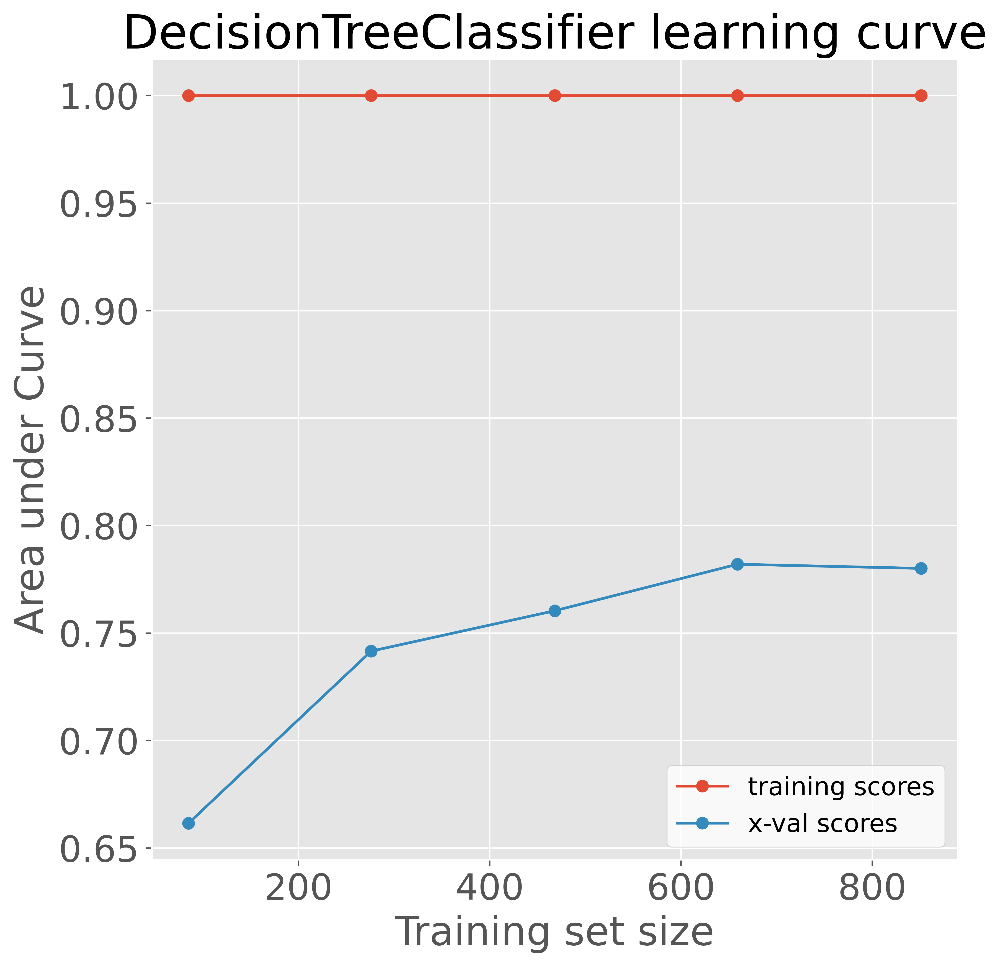

In [119]:
tr_clf=DecisionTreeClassifier(random_state=42)  # 决策树模型
plot_learning_curves(tr_clf, data_train_X, y_train)

In [120]:
param_distribs = {
         'max_features': ['auto', 'log2'],
        'max_depth': stats.randint(low=1, high=50),
        'min_samples_split': stats.randint(low=2, high=200), 
        'min_samples_leaf': stats.randint(low=2, high=200)
    }
dt_clf = DecisionTreeClassifier(random_state=42,criterion='gini', splitter='best')
rnd_search = RandomizedSearchCV(dt_clf, param_distributions=param_distribs, return_train_score=True,
                                n_iter=100, cv=5, scoring='roc_auc', random_state=42, n_jobs=-1)
gsdt=rnd_search.fit(data_train_X, y_train)

`max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.


In [121]:
print(gsdt.best_score_)

0.7645022008697012


In [122]:
print(gsdt.best_params_)

{'max_depth': 22, 'max_features': 'auto', 'min_samples_leaf': 3, 'min_samples_split': 89}


In [123]:
cv_rlt = rnd_search.cv_results_
pd.DataFrame(sorted(list(zip(cv_rlt["mean_test_score"], cv_rlt['mean_train_score'], cv_rlt["params"])), 
                    key=lambda x: x[0], reverse=True), columns=['X-val scores', 'Train scores', 'Params'])

,X-val scores,Train scores,Params
0,0.764502,0.837648,"{'max_depth': 22, 'max_features': 'auto', 'min_samples_leaf': 3, 'min_samples_split': 89}"
1,0.763888,0.819527,"{'max_depth': 27, 'max_features': 'auto', 'min_samples_leaf': 16, 'min_samples_split': 91}"
2,0.754988,0.814292,"{'max_depth': 8, 'max_features': 'auto', 'min_samples_leaf': 28, 'min_samples_split': 22}"
3,0.751728,0.806070,"{'max_depth': 10, 'max_features': 'log2', 'min_samples_leaf': 15, 'min_samples_split': 96}"
4,0.746280,0.781482,"{'max_depth': 30, 'max_features': 'auto', 'min_samples_leaf': 29, 'min_samples_split': 112}"
...,...,...,...
95,0.605551,0.617174,"{'max_depth': 46, 'max_features': 'log2', 'min_samples_leaf': 195, 'min_samples_split': 55}"
96,0.600668,0.620606,"{'max_depth': 2, 'max_features': 'auto', 'min_samples_leaf': 173, 'min_samples_split': 161}"
97,0.600415,0.614015,"{'max_depth': 19, 'max_features': 'log2', 'min_samples_leaf': 196, 'min_samples_split': 148}"
98,0.600415,0.614015,"{'max_depth': 8, 'max_features': 'auto', 'min_samples_leaf': 196, 'min_samples_split': 146}"


In [124]:
dt_clf = rnd_search.best_estimator_
dt_clf.fit(data_train_X, y_train)
with open('F:/materi/11-LZ-PerCI and spine fractures/Figures and投稿/10.0 JMIR/Data/dt_clf_final_round.pkl', 'wb') as f:
    pickle.dump(dt_clf, f)

`max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.


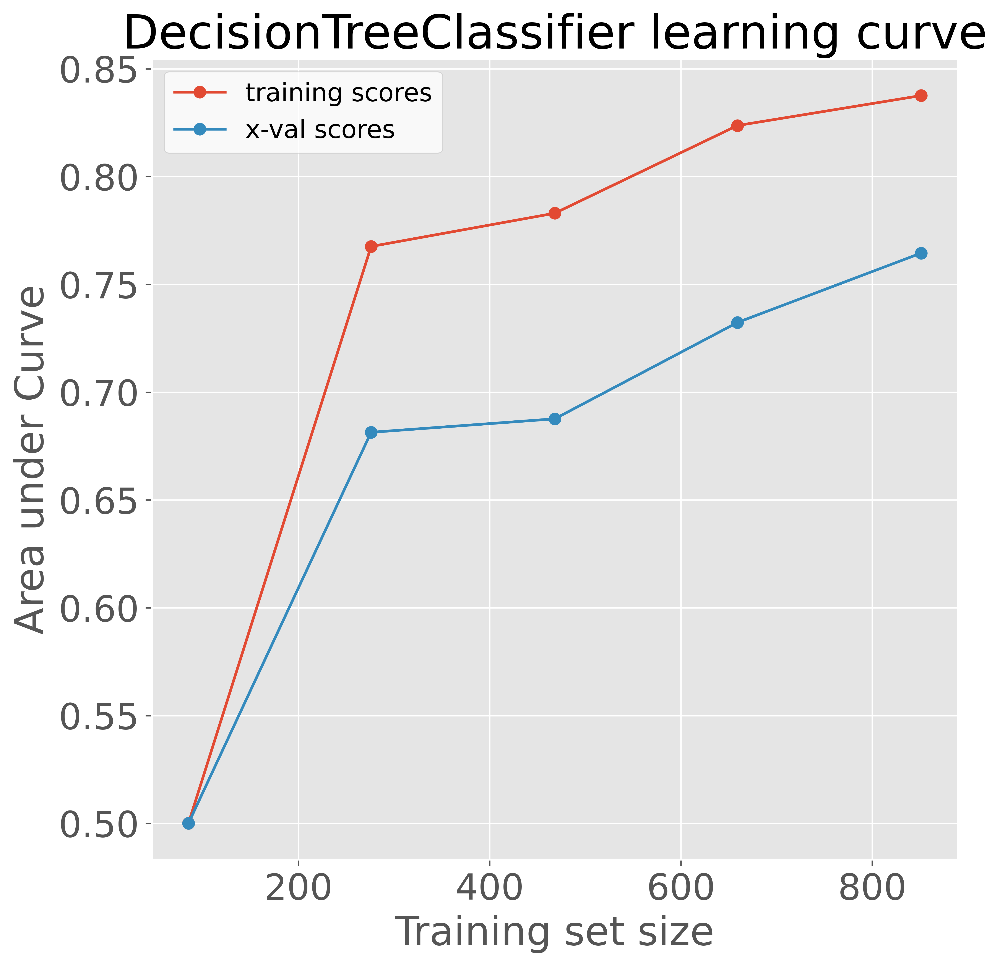

In [125]:
plot_learning_curves(dt_clf, data_train_X, y_train)

# Decision Tree ROC计算

In [126]:
# Import model and retrain
with open('F:/materi/11-LZ-PerCI and spine fractures/Figures and投稿/10.0 JMIR/Data/dt_clf_final_round.pkl', 'rb') as f:
    dt_clf = pickle.load(f)
dt_clf.fit(data_train_X, y_train)

`max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.


DecisionTreeClassifier(max_depth=22, max_features='auto', min_samples_leaf=3,
                       min_samples_split=89, random_state=42)

In [127]:
accu_dt = accuracy_score(y_test, dt_clf.predict(data_test_X))
round(accu_dt,3)

0.688

In [128]:
pd.crosstab(y_test, dt_clf.predict(data_test_X))

col_0,0,1
Group,,
0,83,50
1,33,100


In [129]:
pred_proba_dt = dt_clf.predict_proba(data_test_X)
fpr, tpr, _ = roc_curve(y_test, pred_proba_dt[:, 1])
auc_dt = roc_auc_score(y_test, pred_proba_dt[:, 1])
round(auc_dt,3)

0.747

In [130]:
dt_score = dt_clf.score(data_test_X, y_test)
dt_accuracy_score=accuracy_score(y_test,dt_clf.predict(data_test_X))
dt_preci_score=precision_score(y_test,dt_clf.predict(data_test_X))
dt_recall_score=recall_score(y_test,dt_clf.predict(data_test_X))
dt_f1_score=f1_score(y_test,dt_clf.predict(data_test_X))
dt_auc=roc_auc_score(y_test,pred_proba_dt[:, 1])
print('dt_accuracy_score: %f,dt_preci_score: %f,dt_recall_score: %f,dt_f1_score: %f,dt_auc: %f'
      %(dt_accuracy_score,dt_preci_score,dt_recall_score,dt_f1_score,dt_auc))

dt_accuracy_score: 0.687970,dt_preci_score: 0.666667,dt_recall_score: 0.751880,dt_f1_score: 0.706714,dt_auc: 0.747131


In [131]:
brier_score_loss(y_test, pred_proba_dt[:, 1])

0.20555200233396723

In [132]:
print('loss dt:', log_loss(y_test, pred_proba_dt[:, 1]))

loss dt: 0.7168045321597166


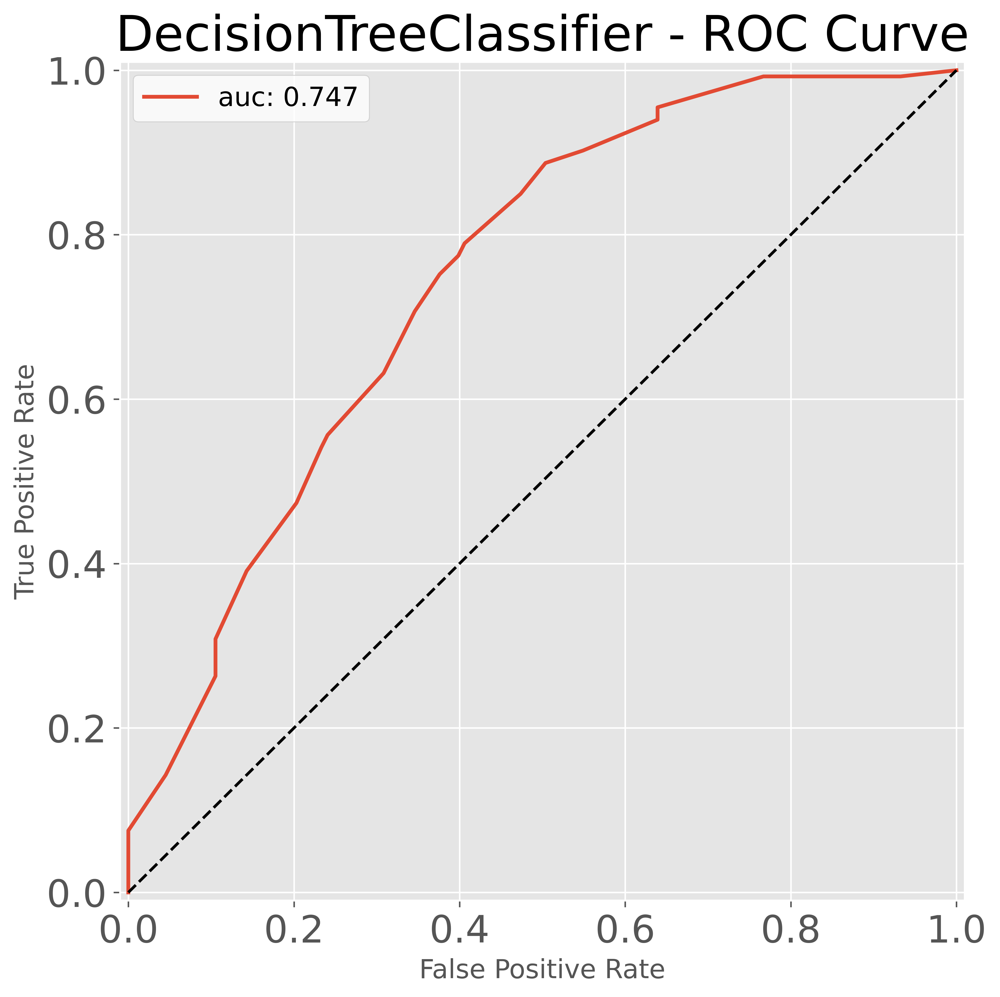

In [133]:
plot_roc_curve(fpr, tpr, round(auc_dt,3), dt_clf)

In [134]:
X_test['lr_pred_proba'] = pred_proba_dt[:, 1]

In [135]:
dt_his = X_test.join(y_test)

In [136]:
dt_his.to_csv('F:/materi/11-LZ-PerCI and spine fractures/Figures and投稿/10.0 JMIR/Data/test_set_with_predictions-decision tree.csv'.format(len(dt_his)), index=False)

In [ ]:
dt_his = X_test.join(y_test)
dt_his.shape

plot_class_breakdown_hist(dt_his, 'lr_pred_proba', var_name='Decision Tree Risk', 
                          plot_title='Decision Tree Class Breakdown', bins=100)

In [138]:
y_dt = y_test
scores_dt = pred_proba_dt[:, 1]
statistics_dt = bootstrap_auc(y_dt,scores_dt,[0,1])
print("均值:",np.mean(statistics_dt,axis=1))
print("最大值:",np.max(statistics_dt,axis=1))
print("最小值:",np.min(statistics_dt,axis=1))

均值: [0.7469521 0.7481297]
最大值: [0.781546 0.786036]
最小值: [0.715098 0.712956]


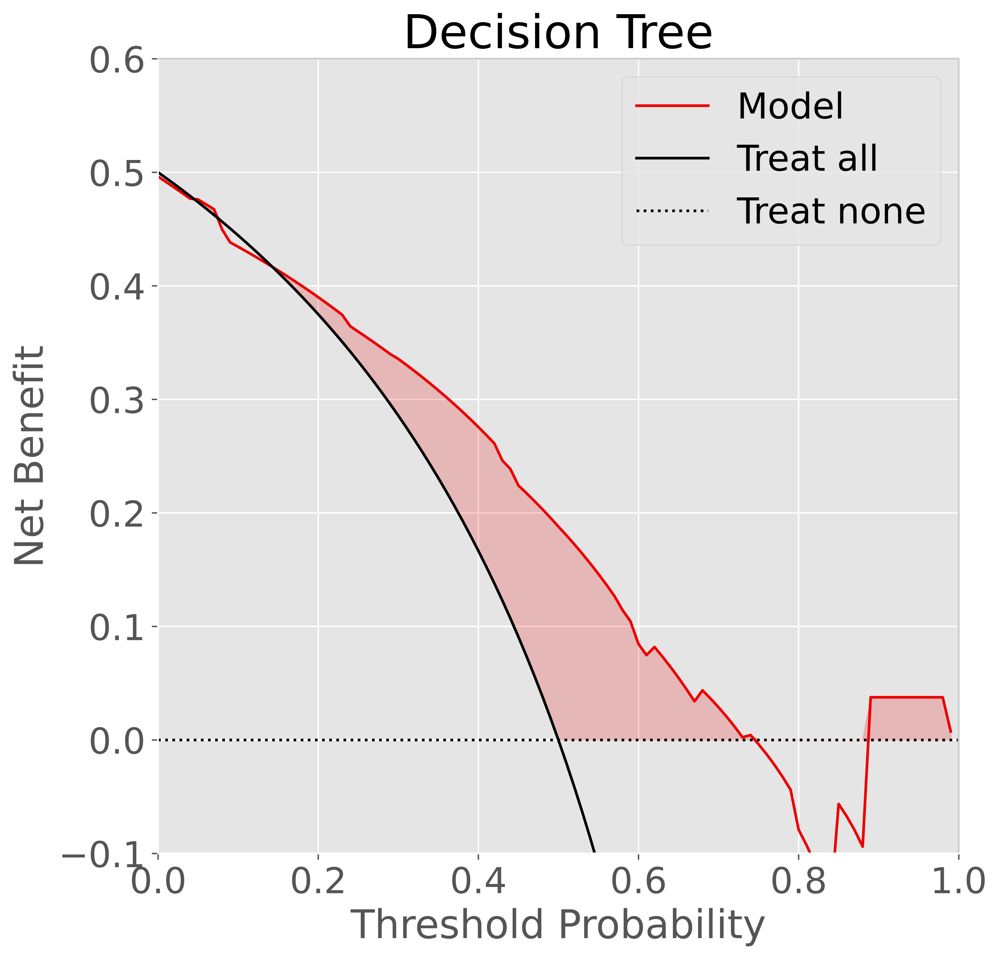

<Figure size 7200x2400 with 0 Axes>

In [139]:
thresh_group = np.arange(0,1,0.01)
net_benefit_model = calculate_net_benefit_model(thresh_group, pred_proba_dt[:, 1], y_test)
net_benefit_all = calculate_net_benefit_all(thresh_group, y_test)
fig, ax = plt.subplots()
ax = plot_DCA(ax, thresh_group, net_benefit_model, net_benefit_all)
# fig.savefig('fig1.png', dpi = 300)
plt.title("Decision Tree")
#plt.figure(figsize=(10, 10), dpi=600)
plt.figure(dpi=300,figsize=(24,8))
plt.show()

# 决策树图片

In [133]:
from sklearn.tree import DecisionTreeClassifier
from IPython.display import Image  
from sklearn import tree
import pydotplus

In [134]:
# 创建 DOT data
dot_data = tree.export_graphviz(dt_clf, out_file=None, 
                                feature_names=data_train_X.columns,  
                                class_names=['Alive','Death'],
                                filled=True, rounded=True,  
                                special_characters=True)
# 绘图
graph = pydotplus.graph_from_dot_data(dot_data)  


In [135]:
from IPython.display import Image


(process:10944): GLib-GIO-WARNING **: 17:39:05.737: Unexpectedly, UWP app `Clipchamp.Clipchamp_2.5.15.0_neutral__yxz26nhyzhsrt' (AUMId `Clipchamp.Clipchamp_yxz26nhyzhsrt!App') supports 41 extensions but has no verbs

(process:10944): GLib-GIO-WARNING **: 17:39:05.784: Unexpectedly, UWP app `Microsoft.ScreenSketch_11.2302.20.0_x64__8wekyb3d8bbwe' (AUMId `Microsoft.ScreenSketch_8wekyb3d8bbwe!App') supports 29 extensions but has no verbs



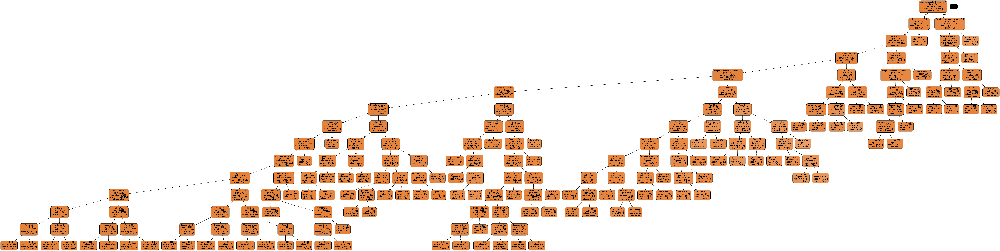

In [136]:
# 展现图形
Image(graph.create_png()) 

# KNN机器学习算法

In [140]:
from sklearn.neighbors import KNeighborsClassifier

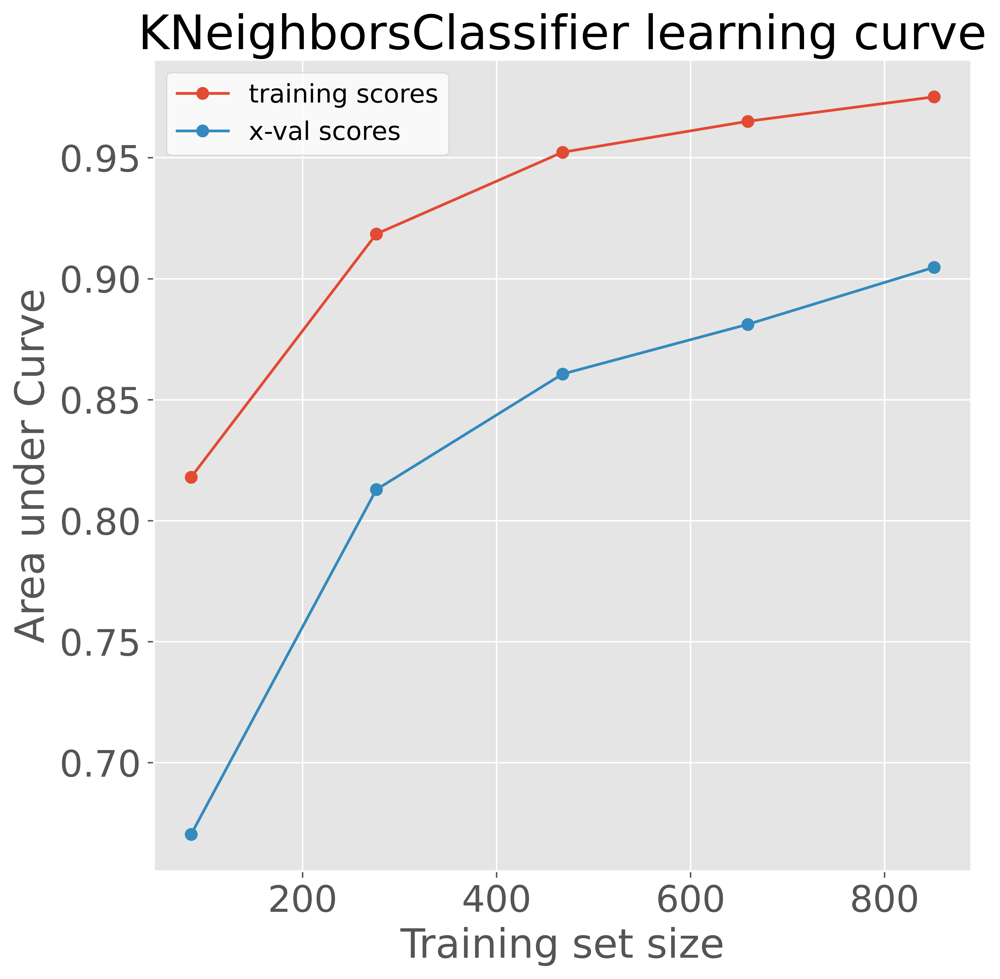

In [141]:
knn_clf=KNeighborsClassifier()  # 决策树模型
plot_learning_curves(knn_clf, data_train_X, y_train)

In [142]:
from sklearn.model_selection import GridSearchCV
param_grid = [
    { 'weights':['uniform'],
     'n_neighbors':[i for i in range (1,11)]##网上多为设置为11
    },
    {
        'weights':['distance'],
        'n_neighbors':[i for i in range (1,11)],##网上多为设置为11
        'p':[i for i in range(1,6)]
    }
]

grid_search_knn = GridSearchCV(knn_clf, param_grid, cv=5, n_jobs=-1, verbose=10)

grid_search_knn.fit(data_train_X, y_train)

Fitting 5 folds for each of 60 candidates, totalling 300 fits


GridSearchCV(cv=5, estimator=KNeighborsClassifier(), n_jobs=-1,
             param_grid=[{'n_neighbors': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10],
                          'weights': ['uniform']},
                         {'n_neighbors': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10],
                          'p': [1, 2, 3, 4, 5], 'weights': ['distance']}],
             verbose=10)

In [143]:
grid_search_knn.best_score_

0.8656435468154839

In [144]:
grid_search_knn.best_params_

{'n_neighbors': 2, 'weights': 'uniform'}

In [145]:
grid_search_knn.best_estimator_

KNeighborsClassifier(n_neighbors=2)

In [146]:
knn_clf = grid_search_knn.best_estimator_
knn_clf.fit(data_train_X, y_train)
with open('F:/materi/11-LZ-PerCI and spine fractures/Figures and投稿/10.0 JMIR/Data/knn_clf_final_round.pkl', 'wb') as f:
    pickle.dump(knn_clf, f)

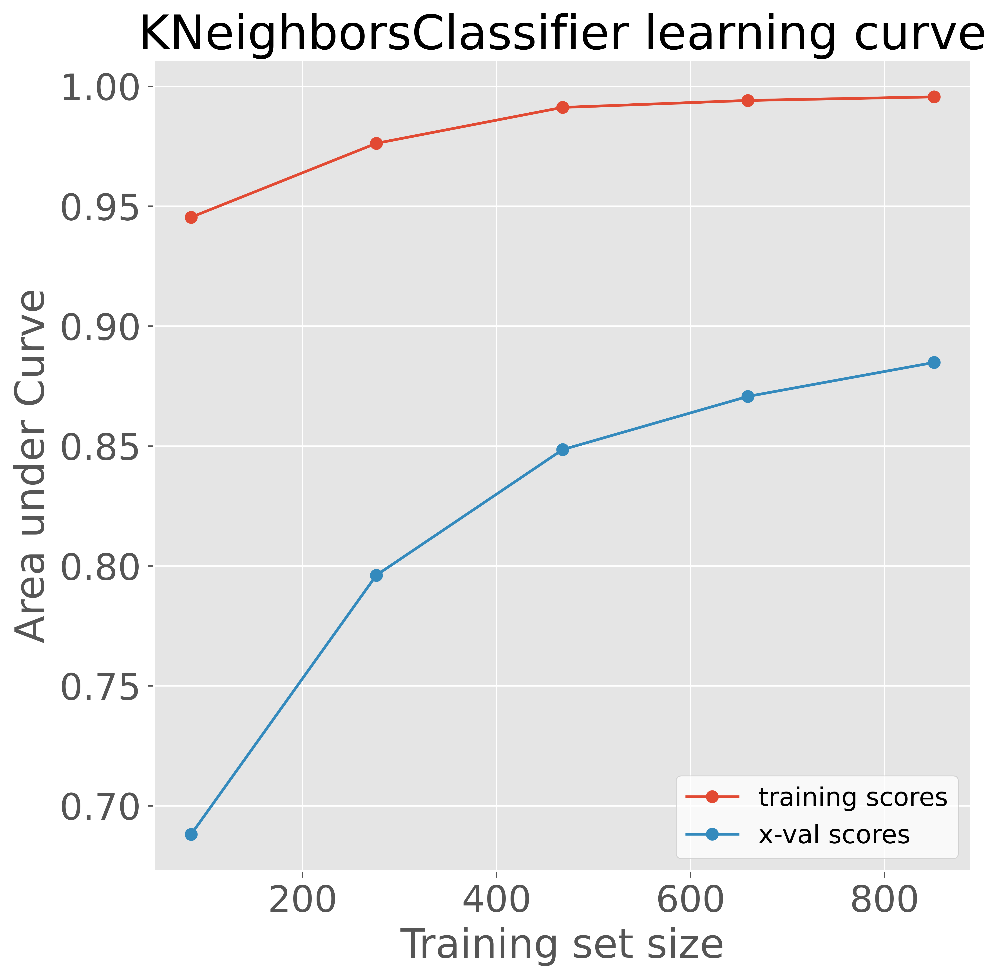

In [147]:
plot_learning_curves(knn_clf, data_train_X, y_train)

# KNN-ROC

In [148]:
# Import model and retrain
with open('F:/materi/11-LZ-PerCI and spine fractures/Figures and投稿/10.0 JMIR/Data/knn_clf_final_round.pkl', 'rb') as f:
    knn_clf = pickle.load(f)
knn_clf.fit(data_train_X, y_train)

KNeighborsClassifier(n_neighbors=2)

In [149]:
knn_clf

KNeighborsClassifier(n_neighbors=2)

In [150]:
accu_knn = accuracy_score(y_test, knn_clf.predict(data_test_X))
round(accu_knn,3)

0.857

In [151]:
pd.crosstab(y_test, knn_clf.predict(data_test_X))

col_0,0,1
Group,,
0,110,23
1,15,118


In [152]:
pred_proba_knn = knn_clf.predict_proba(data_test_X)
fpr, tpr, _ = roc_curve(y_test, pred_proba_knn[:, 1])
auc_knn = roc_auc_score(y_test, pred_proba_knn[:, 1])
round(auc_knn,3)

0.883

In [153]:
knn_score = knn_clf.score(data_test_X, y_test)
knn_accuracy_score=accuracy_score(y_test,knn_clf.predict(data_test_X))
knn_preci_score=precision_score(y_test,knn_clf.predict(data_test_X))
knn_recall_score=recall_score(y_test,knn_clf.predict(data_test_X))
knn_f1_score=f1_score(y_test,knn_clf.predict(data_test_X))
knn_auc=roc_auc_score(y_test,pred_proba_knn[:, 1])
print('knn_accuracy_score: %f,knn_preci_score: %f,knn_recall_score: %f,knn_f1_score: %f,knn_auc: %f'
      %(knn_accuracy_score,knn_preci_score,knn_recall_score,knn_f1_score,knn_auc))

knn_accuracy_score: 0.857143,knn_preci_score: 0.836879,knn_recall_score: 0.887218,knn_f1_score: 0.861314,knn_auc: 0.882724


In [154]:
brier_score_loss(y_test, pred_proba_knn[:, 1])

0.13909774436090225

In [155]:
print('loss knn:', log_loss(y_test, pred_proba_knn[:, 1]))

loss knn: 3.3712739296260867


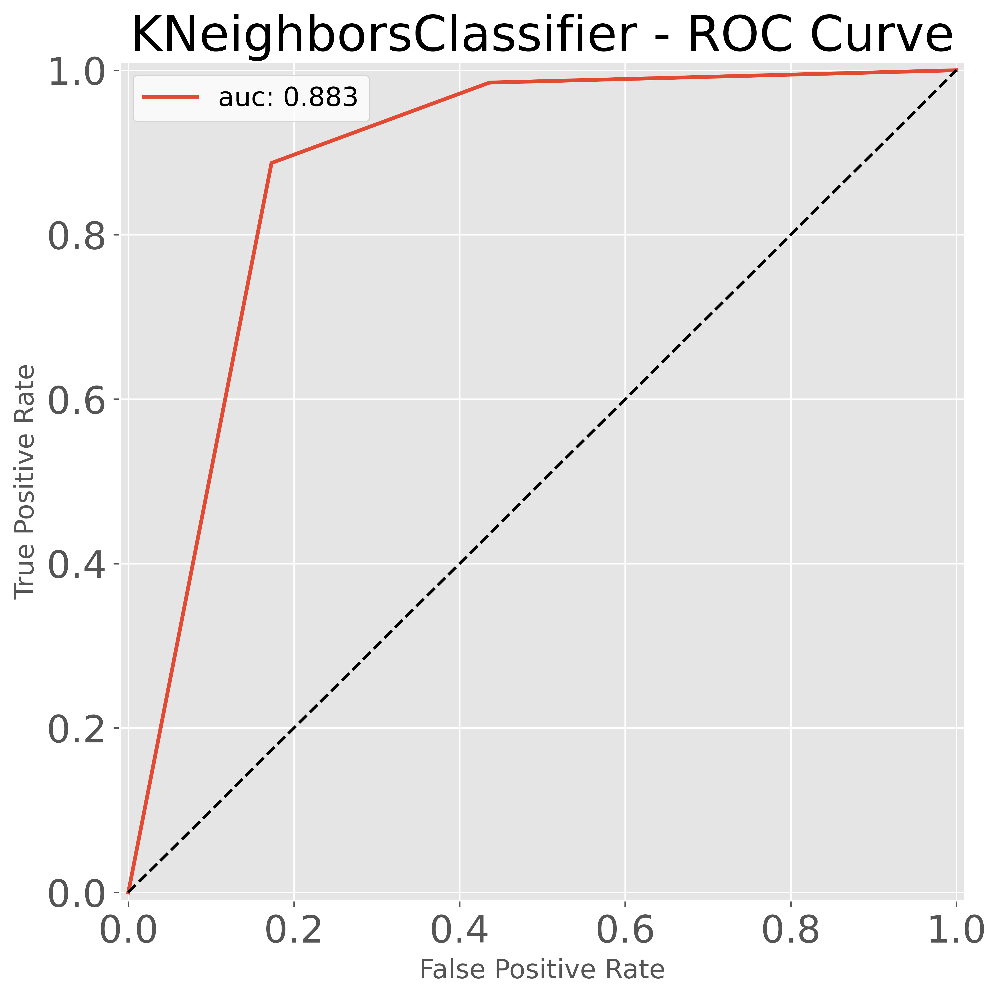

In [156]:
plot_roc_curve(fpr, tpr, round(auc_knn,3), knn_clf)

In [157]:
X_test['lr_pred_proba'] = pred_proba_knn[:, 1]

knn_his = X_test.join(y_test)

In [158]:
knn_his.to_csv('F:/materi/11-LZ-PerCI and spine fractures/Figures and投稿/10.0 JMIR/Data/test_set_with_predictions-knn.csv'.format(len(knn_his)), index=False)

In [159]:
y_knn = y_test
scores_knn = pred_proba_knn[:, 1]
statistics_knn = bootstrap_auc(y_knn,scores_knn,[0,1])
print("均值:",np.mean(statistics_knn,axis=1))
print("最大值:",np.max(statistics_knn,axis=1))
print("最小值:",np.min(statistics_knn,axis=1))

均值: [0.88273864 0.88194616]
最大值: [0.902576 0.907874]
最小值: [0.850482 0.861368]


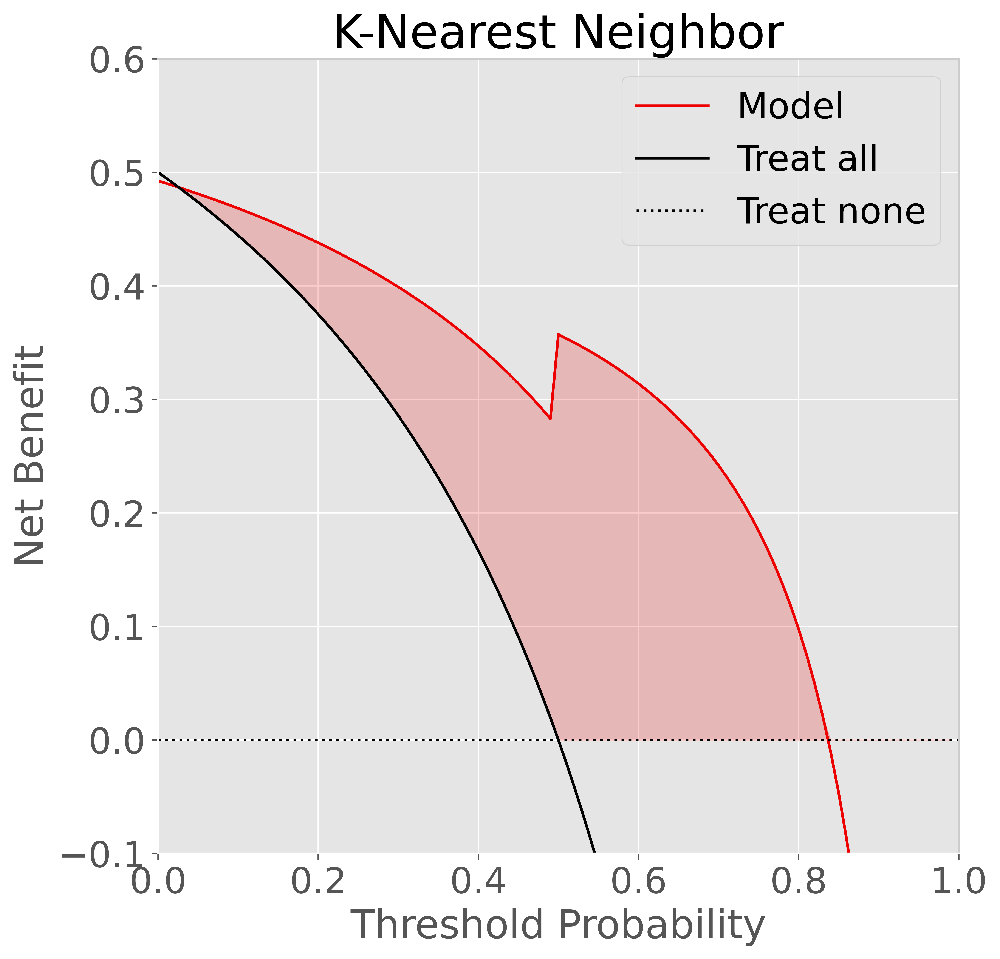

<Figure size 7200x2400 with 0 Axes>

In [160]:
thresh_group = np.arange(0,1,0.01)
net_benefit_model = calculate_net_benefit_model(thresh_group, pred_proba_knn[:, 1], y_test)
net_benefit_all = calculate_net_benefit_all(thresh_group, y_test)
fig, ax = plt.subplots()
ax = plot_DCA(ax, thresh_group, net_benefit_model, net_benefit_all)
# fig.savefig('fig1.png', dpi = 300)
plt.title("K-Nearest Neighbor")
#plt.figure(figsize=(10, 10), dpi=600)
plt.figure(dpi=300,figsize=(24,8))
#plt.ylim(0, 0.5)
plt.show()

# Random Forests classifier---随机搜索模型调参RandomizedSearchCV
Random forests classifier is an ensemble tree-based model that reduces the variance of the predictors.

plot the learning curve to find out where the default model is at

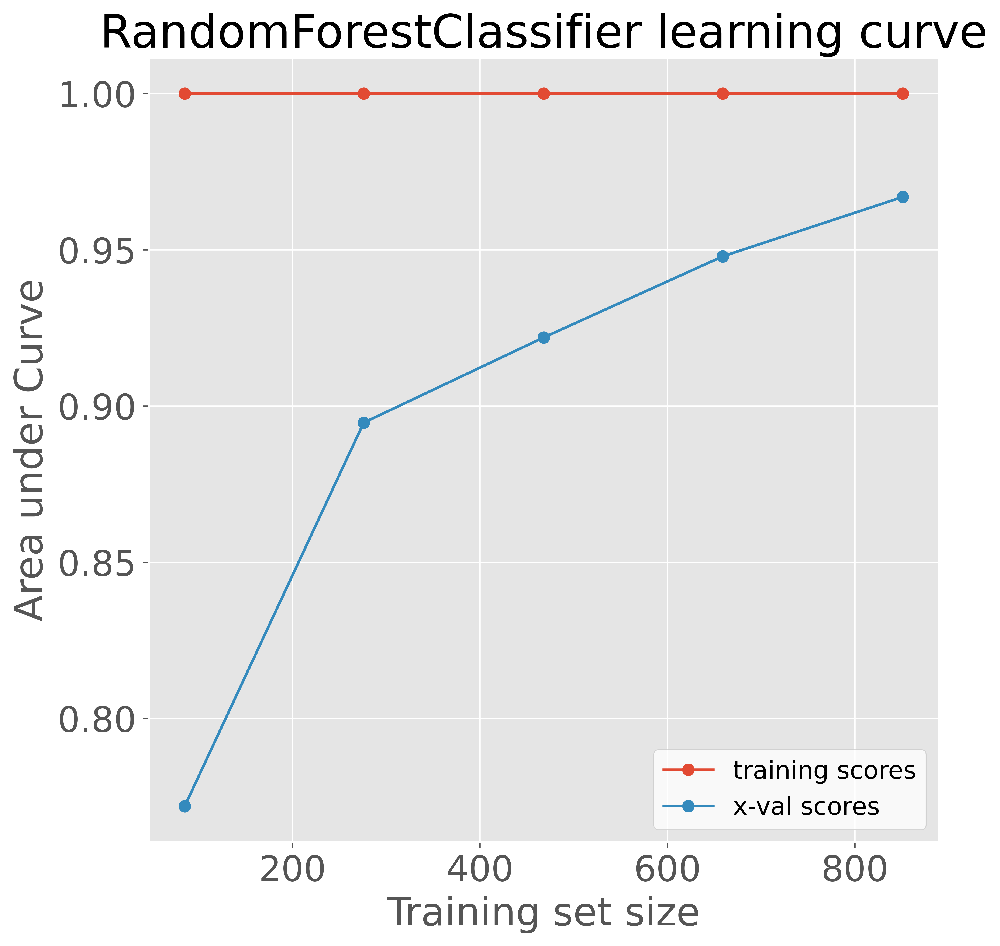

In [161]:
rf_clf = RandomForestClassifier(random_state=42)
plot_learning_curves(rf_clf, data_train_X, y_train)

In [162]:
param_distribs = {
        'n_estimators': stats.randint(low=1, high=50),
         'max_features': ['auto', 'log2'],
        'max_depth': stats.randint(low=1, high=100),
        'min_samples_split': stats.randint(low=2, high=200), 
        'min_samples_leaf': stats.randint(low=2, high=200)
    }
rf_clf = RandomForestClassifier(random_state=42)
rnd_search = RandomizedSearchCV(rf_clf, param_distributions=param_distribs, return_train_score=True,
                                n_iter=100, cv=5, scoring='roc_auc', random_state=42, n_jobs=-1)
gs=rnd_search.fit(data_train_X, y_train)

`max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.


In [163]:
print(gs.best_score_)

0.9418843969483935


In [164]:
print(gs.best_params_)

{'max_depth': 78, 'max_features': 'auto', 'min_samples_leaf': 2, 'min_samples_split': 6, 'n_estimators': 26}


In [165]:
cv_rlt = rnd_search.cv_results_
pd.DataFrame(sorted(list(zip(cv_rlt["mean_test_score"], cv_rlt['mean_train_score'], cv_rlt["params"])), 
                    key=lambda x: x[0], reverse=True), columns=['X-val scores', 'Train scores', 'Params'])

,X-val scores,Train scores,Params
0,0.941884,0.999621,"{'max_depth': 78, 'max_features': 'auto', 'min_samples_leaf': 2, 'min_samples_split': 6, 'n_estimators': 26}"
1,0.839390,0.917820,"{'max_depth': 27, 'max_features': 'auto', 'min_samples_leaf': 22, 'min_samples_split': 31, 'n_estimators': 33}"
2,0.836435,0.904412,"{'max_depth': 51, 'max_features': 'auto', 'min_samples_leaf': 22, 'min_samples_split': 74, 'n_estimators': 39}"
3,0.826551,0.891383,"{'max_depth': 32, 'max_features': 'auto', 'min_samples_leaf': 10, 'min_samples_split': 100, 'n_estimators': 19}"
4,0.819032,0.880985,"{'max_depth': 42, 'max_features': 'auto', 'min_samples_leaf': 27, 'min_samples_split': 100, 'n_estimators': 25}"
...,...,...,...
95,0.687101,0.707400,"{'max_depth': 88, 'max_features': 'log2', 'min_samples_leaf': 159, 'min_samples_split': 39, 'n_estimators': 2}"
96,0.685836,0.717310,"{'max_depth': 96, 'max_features': 'auto', 'min_samples_leaf': 130, 'min_samples_split': 148, 'n_estimators': 2}"
97,0.685005,0.709157,"{'max_depth': 24, 'max_features': 'auto', 'min_samples_leaf': 151, 'min_samples_split': 54, 'n_estimators': 2}"
98,0.678359,0.706751,"{'max_depth': 63, 'max_features': 'auto', 'min_samples_leaf': 161, 'min_samples_split': 162, 'n_estimators': 3}"


In [166]:
rf_clf = rnd_search.best_estimator_
rf_clf.fit(data_train_X, y_train)
with open('F:/materi/11-LZ-PerCI and spine fractures/Figures and投稿/10.0 JMIR/Data/rf_clf_final_round.pkl', 'wb') as f:
    pickle.dump(rf_clf, f)

`max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.


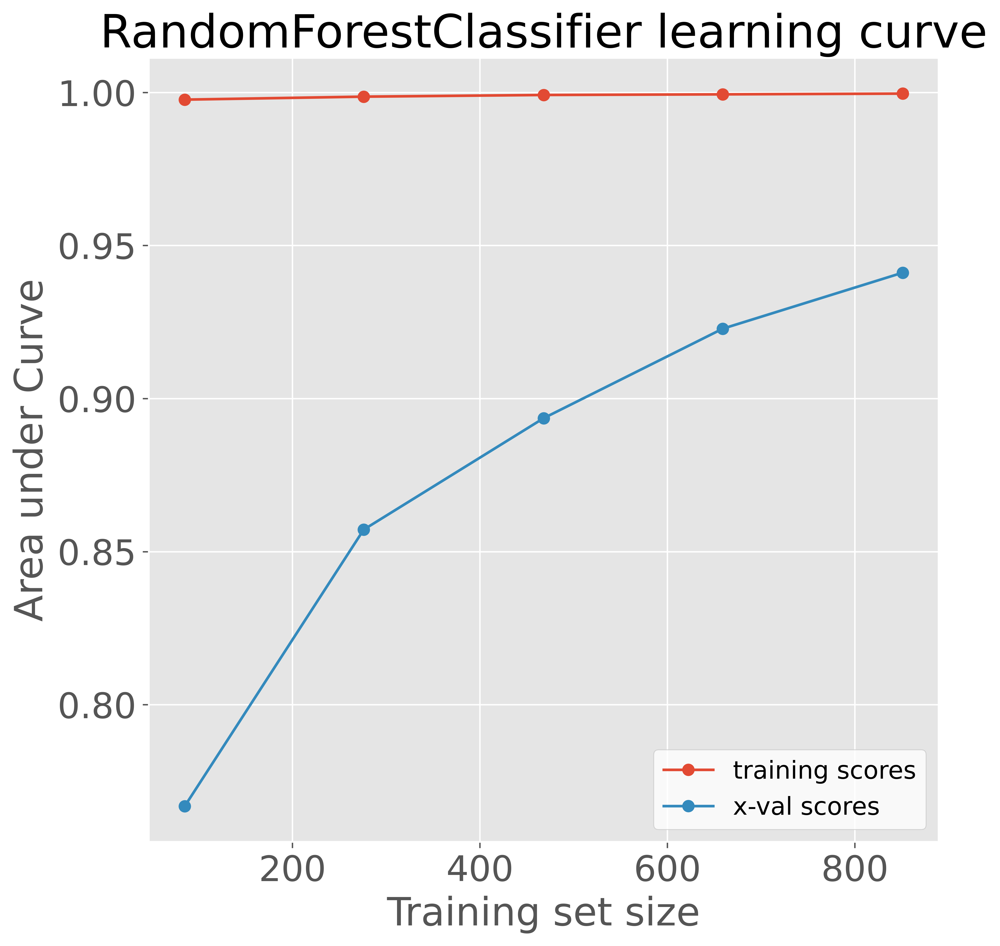

In [167]:
plot_learning_curves(rf_clf, data_train_X, y_train)

# Random forests model-ROC

In [168]:
# Import model and retrain
with open('F:/materi/11-LZ-PerCI and spine fractures/Figures and投稿/10.0 JMIR/Data/rf_clf_final_round.pkl', 'rb') as f:
    rf_clf = pickle.load(f)
rf_clf.fit(data_train_X, y_train)

`max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.


RandomForestClassifier(max_depth=78, max_features='auto', min_samples_leaf=2,
                       min_samples_split=6, n_estimators=26, random_state=42)

Accuracy scores

In [169]:
accu_rf = accuracy_score(y_test, rf_clf.predict(data_test_X))

In [170]:
round(accu_rf,3)

0.872

In [171]:
pd.crosstab(y_test, rf_clf.predict(data_test_X))

col_0,0,1
Group,,
0,115,18
1,16,117


ROC and AUC

In [172]:
pred_proba_rf = rf_clf.predict_proba(data_test_X)

In [173]:
fpr, tpr, _ = roc_curve(y_test, pred_proba_rf[:, 1])
auc_rf = roc_auc_score(y_test, pred_proba_rf[:, 1])

In [174]:
rf_score = rf_clf.score(data_test_X, y_test)
rf_accuracy_score=accuracy_score(y_test,rf_clf.predict(data_test_X))
rf_preci_score=precision_score(y_test,rf_clf.predict(data_test_X))
rf_recall_score=recall_score(y_test,rf_clf.predict(data_test_X))
rf_f1_score=f1_score(y_test,rf_clf.predict(data_test_X))
rf_auc=roc_auc_score(y_test,pred_proba_rf[:, 1])
print('rf_accuracy_score: %f,rf_preci_score: %f,rf_recall_score: %f,rf_f1_score: %f,rf_auc: %f'
      %(rf_accuracy_score,rf_preci_score,rf_recall_score,rf_f1_score,rf_auc))

rf_accuracy_score: 0.872180,rf_preci_score: 0.866667,rf_recall_score: 0.879699,rf_f1_score: 0.873134,rf_auc: 0.956696


accuracy计算第二种方法

In [175]:
from sklearn import metrics
def calculate_accuracy_sklearn(y, y_pred):
    return metrics.accuracy_score(y, y_pred)
calculate_accuracy_sklearn(y_test,rf_clf.predict(data_test_X))

0.8721804511278195

Brier score计算

In [176]:
from sklearn.metrics import brier_score_loss
brier_score_loss(y_test, pred_proba_rf[:, 1])

0.10443392233261839

第二种方法计算Brier score

In [177]:
def brier_score(y, y_pred):
    s=0
    for i, j in zip(y, y_pred):
        s += (j-i)**2
    return s * (1/len(y))

In [178]:
brier_score(y_test, pred_proba_rf[:, 1])

0.10443392233261839

Log loss计算

In [179]:
from sklearn.metrics import log_loss
print('loss rf:', log_loss(y_test, pred_proba_rf[:, 1]))

loss rf: 0.3515343966707642


In [180]:
round(auc_rf,3)

0.957

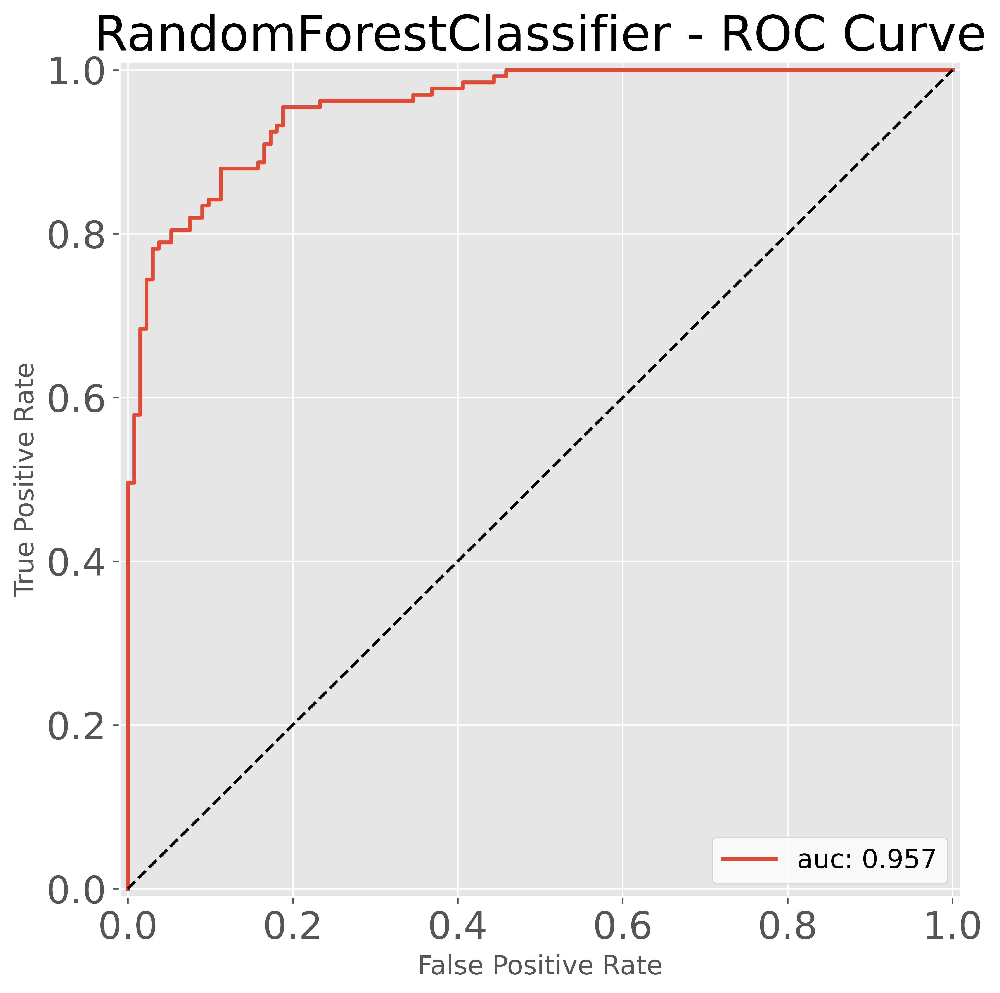

In [181]:
plot_roc_curve(fpr, tpr, round(auc_rf,3), rf_clf)

In [182]:
X_test['lr_pred_proba'] = pred_proba_rf[:, 1]

In [183]:
rf_his = X_test.join(y_test)

In [184]:
rf_his.to_csv('F:/materi/11-LZ-PerCI and spine fractures/Figures and投稿/10.0 JMIR/Data/test_set_with_predictions-Random forests model.csv'.format(len(rf_his)), index=False)

In [ ]:
rf_his = X_test.join(y_test)
rf_his.shape

plot_class_breakdown_hist(rf_his, 'lr_pred_proba', var_name='Random Forest Risk', 
                          plot_title='Random Forest Class Breakdown', bins=100)

In [185]:
y_rf = y_test
scores_rf = pred_proba_rf[:, 1]
statistics_rf = bootstrap_auc(y_rf,scores_rf,[0,1])
print("均值:",np.mean(statistics_rf,axis=1))
print("最大值:",np.max(statistics_rf,axis=1))
print("最小值:",np.min(statistics_rf,axis=1))

均值: [0.95630084 0.95652964]
最大值: [0.966872 0.969488]
最小值: [0.940636 0.943   ]


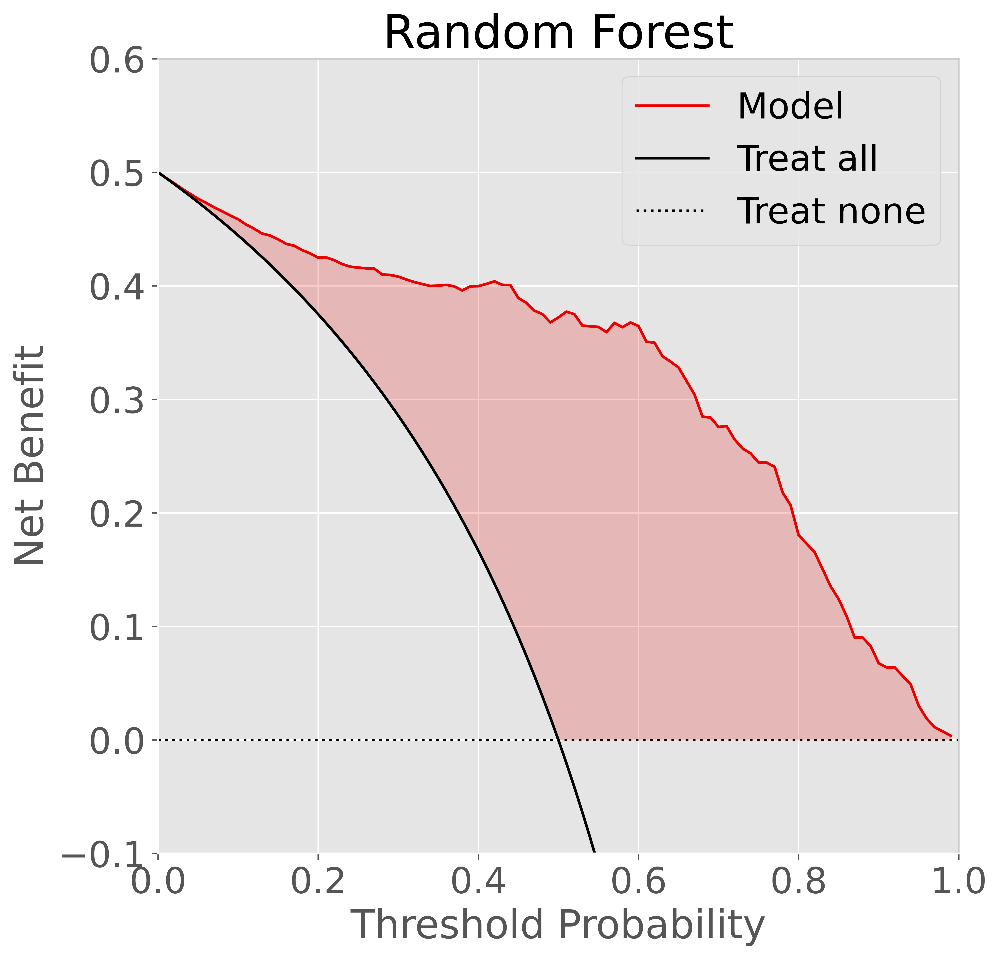

<Figure size 7200x2400 with 0 Axes>

In [186]:
thresh_group = np.arange(0,1,0.01)
net_benefit_model = calculate_net_benefit_model(thresh_group, pred_proba_rf[:, 1], y_test)
net_benefit_all = calculate_net_benefit_all(thresh_group, y_test)
fig, ax = plt.subplots()
ax = plot_DCA(ax, thresh_group, net_benefit_model, net_benefit_all)
# fig.savefig('fig1.png', dpi = 300)
plt.title("Random Forest")
#plt.figure(figsize=(10, 10), dpi=600)
plt.figure(dpi=300,figsize=(24,8))
plt.show()

# Support vector machine classifier---网格搜索模型调参GridSearchCV
Support vector machine classifier is a powerful classifier that works best on small to medium size complex data set. Our training set is medium size to SVMs.

plot the learning curve to find out where the default model is at

Try Linear SVC fist

A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.


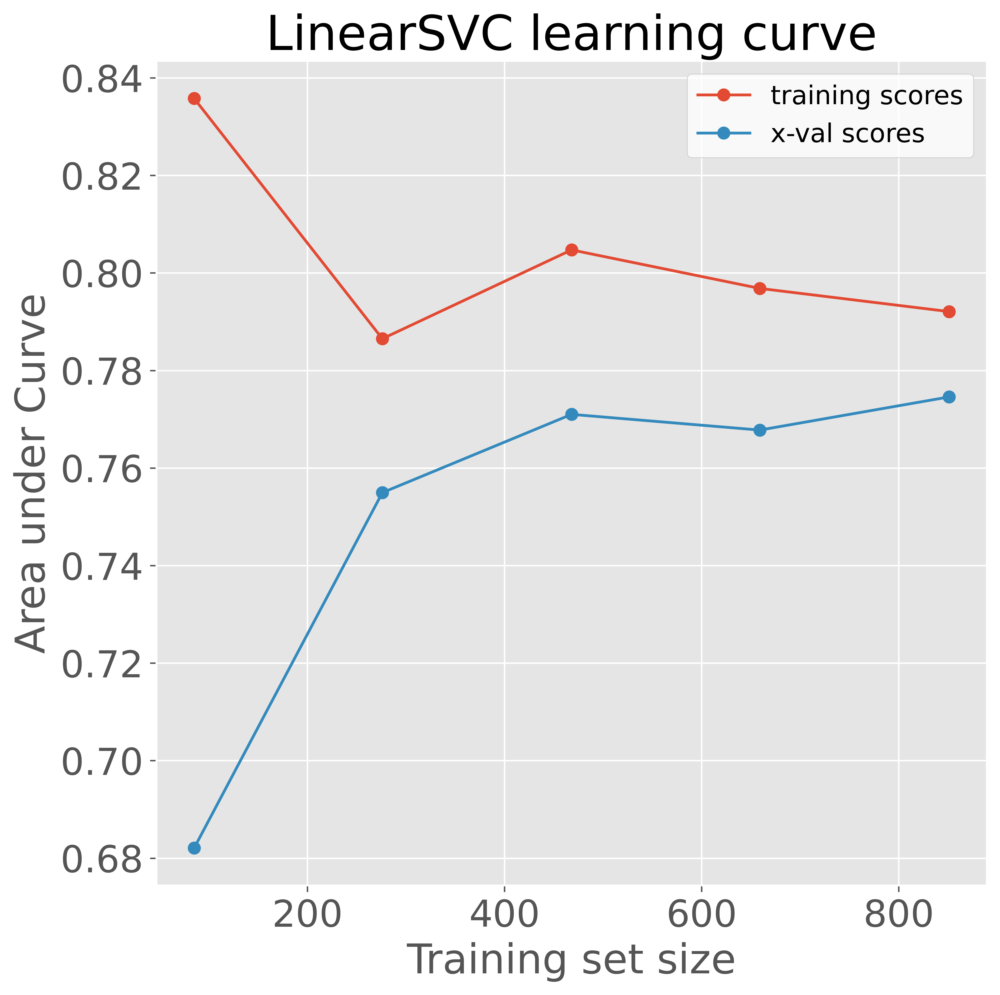

In [256]:
plot_learning_curves(LinearSVC(loss='hinge', random_state=42), data_train_X, y_train)

Try Polynomial kernel

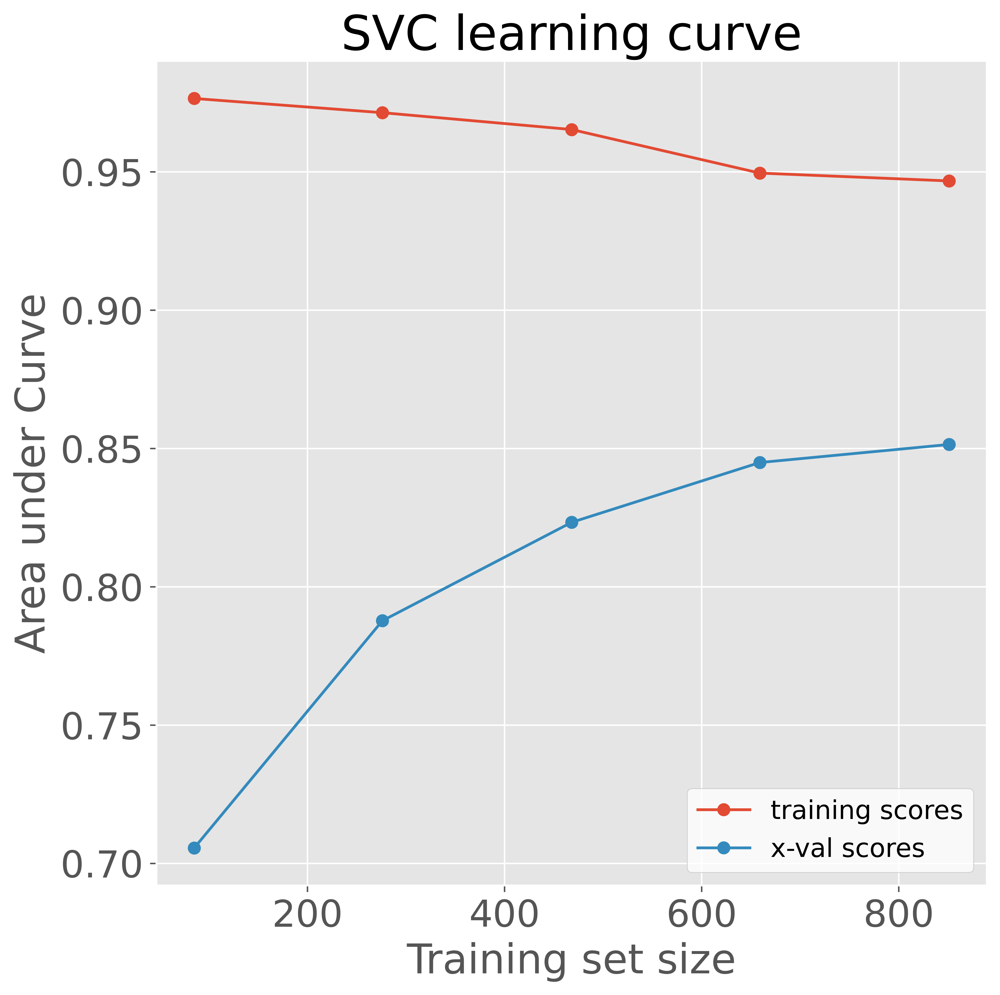

In [257]:
plot_learning_curves(SVC(kernel='poly', random_state=42), data_train_X, y_train)

Try Gaussian RBF kernel

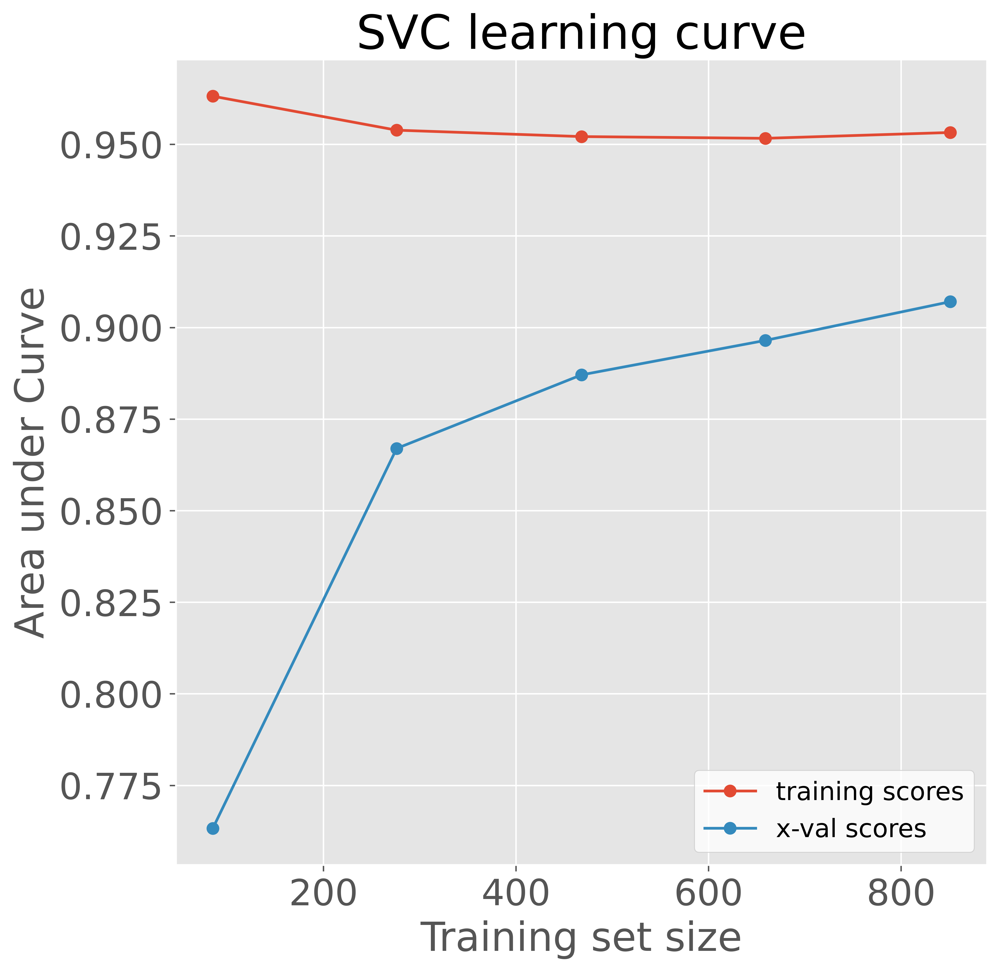

In [258]:
plot_learning_curves(SVC(random_state=42), data_train_X, y_train)

第二调参

In [259]:
hyperparameters = {
 "C": stats.uniform(0.001, 0.1),
 "gamma": stats.uniform(0, 0.5),
 'kernel': ('linear', 'rbf')
}
random = RandomizedSearchCV(estimator = SVC(probability=True), param_distributions = hyperparameters, n_iter = 100, 
                            cv = 5, return_train_score=True, random_state=42, n_jobs = -1)
gssvm = random.fit(data_train_X, y_train)

In [260]:
print(gssvm.best_score_)

0.80079280715741


In [261]:
print(gssvm.best_params_)

{'C': 0.09795846277645587, 'gamma': 0.3875664116805573, 'kernel': 'rbf'}


In [262]:
cv_rlt = random.cv_results_
pd.DataFrame(sorted(list(zip(cv_rlt["mean_test_score"], cv_rlt['mean_train_score'], cv_rlt["params"])), 
                    key=lambda x: x[0], reverse=True), columns=['X-val scores', 'Train scores', 'Params'])

,X-val scores,Train scores,Params
0,0.800793,0.884633,"{'C': 0.09795846277645587, 'gamma': 0.3875664116805573, 'kernel': 'rbf'}"
1,0.793268,0.867010,"{'C': 0.0936300878513349, 'gamma': 0.32553851275097223, 'kernel': 'rbf'}"
2,0.786691,0.860197,"{'C': 0.08731034258755936, 'gamma': 0.31164906341377896, 'kernel': 'rbf'}"
3,0.786691,0.862779,"{'C': 0.08814605901877177, 'gamma': 0.40183603844955723, 'kernel': 'rbf'}"
4,0.784813,0.854086,"{'C': 0.07953406511139437, 'gamma': 0.3344941273571143, 'kernel': 'rbf'}"
...,...,...,...
95,0.561330,0.570423,"{'C': 0.00468869473545328, 'gamma': 0.3047821669899484, 'kernel': 'rbf'}"
96,0.551860,0.559867,"{'C': 0.01833646535077721, 'gamma': 0.1955303037866204, 'kernel': 'rbf'}"
97,0.543405,0.551644,"{'C': 0.010541011649041133, 'gamma': 0.18540912609913318, 'kernel': 'rbf'}"
98,0.536801,0.532395,"{'C': 0.0024079822715084454, 'gamma': 0.09942120204440258, 'kernel': 'rbf'}"


In [263]:
svc_clf = random.best_estimator_
#svc_clf.fit(data_train_X, y_train)
with open('F:/materi/11-LZ-PerCI and spine fractures/Figures and投稿/10.0 JMIR/Data/svc_clf_final_round.pkl', 'wb') as f:
    pickle.dump(svc_clf, f)

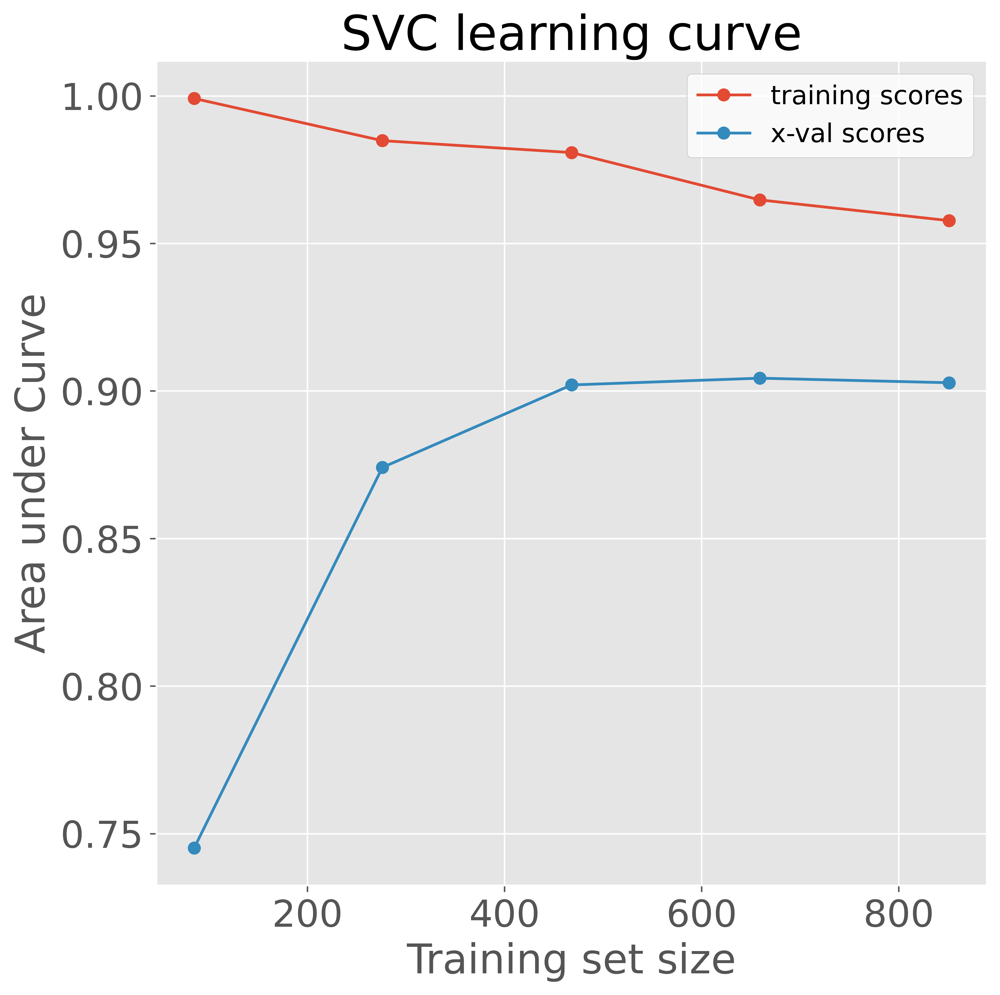

In [264]:
# best model is the default RBF kernal SVM
plot_learning_curves(svc_clf, data_train_X, y_train) 

# SVM-ROC

In [265]:
# Import model and retrain
with open('F:/materi/11-LZ-PerCI and spine fractures/Figures and投稿/10.0 JMIR/Data/svc_clf_final_round.pkl', 'rb') as f:
    svc_clf = pickle.load(f)
svc_clf.fit(data_train_X, y_train)

SVC(C=0.09795846277645587, gamma=0.3875664116805573, probability=True)

In [266]:
accu_svc = accuracy_score(y_test, svc_clf.predict(data_test_X))

In [267]:
round(accu_svc,3)

0.823

In [268]:
pd.crosstab(y_test, svc_clf.predict(data_test_X))

col_0,0,1
Group,,
0,102,31
1,16,117


In [269]:
pred_proba_svc = svc_clf.predict_proba(data_test_X) 

In [270]:
fpr, tpr, _ = roc_curve(y_test, pred_proba_svc[:, 1])
auc_svc = roc_auc_score(y_test, pred_proba_svc[:, 1])

In [271]:
round(auc_svc,3)

0.911

In [272]:
svc_score = svc_clf.score(data_test_X, y_test)
svc_accuracy_score=accuracy_score(y_test,svc_clf.predict(data_test_X))
svc_preci_score=precision_score(y_test,svc_clf.predict(data_test_X))
svc_recall_score=recall_score(y_test,svc_clf.predict(data_test_X))
svc_f1_score=f1_score(y_test,svc_clf.predict(data_test_X))
svc_auc=roc_auc_score(y_test,pred_proba_svc[:, 1])
print('svc_accuracy_score: %f,svc_preci_score: %f,svc_recall_score: %f,svc_f1_score: %f,svc_auc: %f'
      %(svc_accuracy_score,svc_preci_score,svc_recall_score,svc_f1_score,svc_auc))

svc_accuracy_score: 0.823308,svc_preci_score: 0.790541,svc_recall_score: 0.879699,svc_f1_score: 0.832740,svc_auc: 0.910566


In [273]:
brier_score_loss(y_test, pred_proba_svc[:, 1])

0.13658421910230867

In [274]:
print('loss svc:', log_loss(y_test, pred_proba_svc[:, 1]))

loss svc: 0.43801496989205013


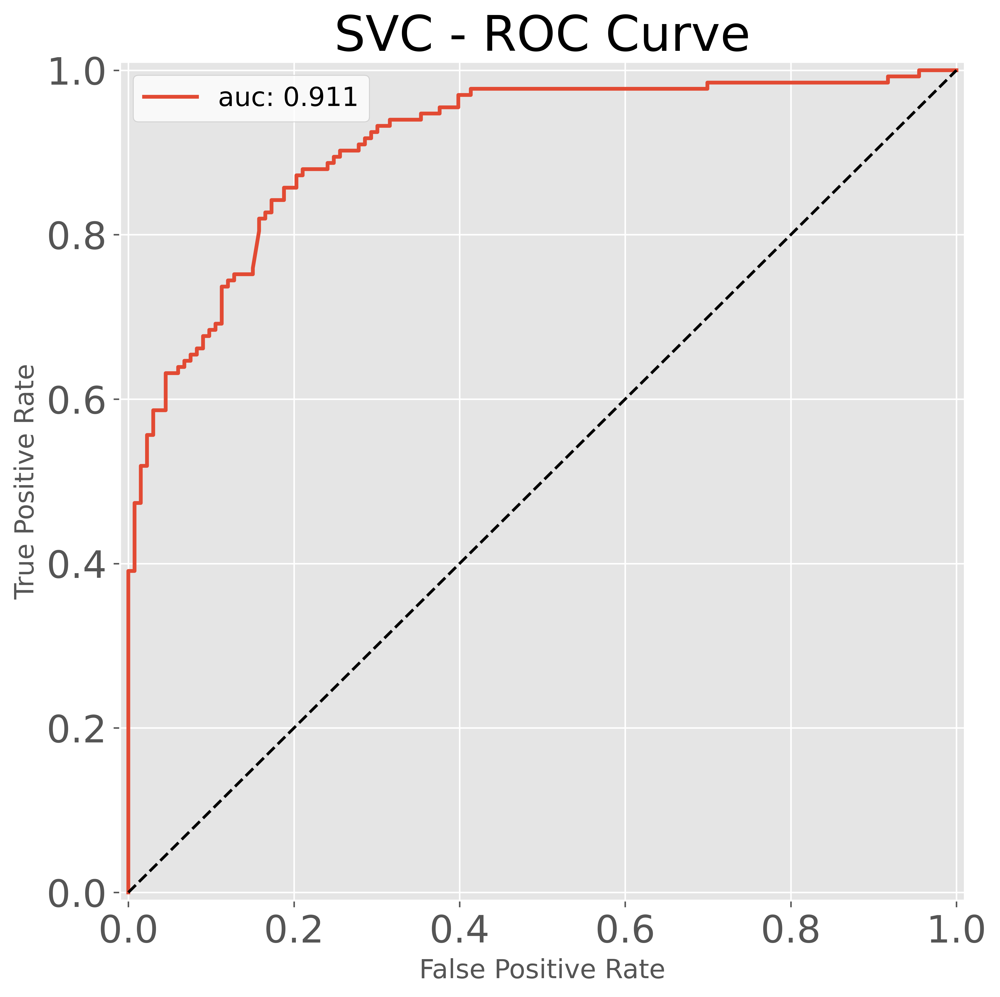

In [275]:
plot_roc_curve(fpr, tpr, round(auc_svc,3), svc_clf)

In [277]:
X_test['lr_pred_proba'] = pred_proba_svc[:, 1]

In [278]:
svm_his = X_test.join(y_test)

In [279]:
svm_his.to_csv('F:/materi/11-LZ-PerCI and spine fractures/Figures and投稿/10.0 JMIR/Data/test_set_with_predictions-Support vector machine model.csv'.format(len(svm_his)), index=False)

In [286]:
y = y_test
scores_svc = pred_proba_svc[:, 1]
statistics_svc = bootstrap_auc(y,scores_svc,[0,1])
print("均值:",np.mean(statistics_svc,axis=1))
print("最大值:",np.max(statistics_svc,axis=1))
print("最小值:",np.min(statistics_svc,axis=1))

均值: [0.91088036 0.9091039 ]
最大值: [0.928278 0.930294]
最小值: [0.878236 0.880916]


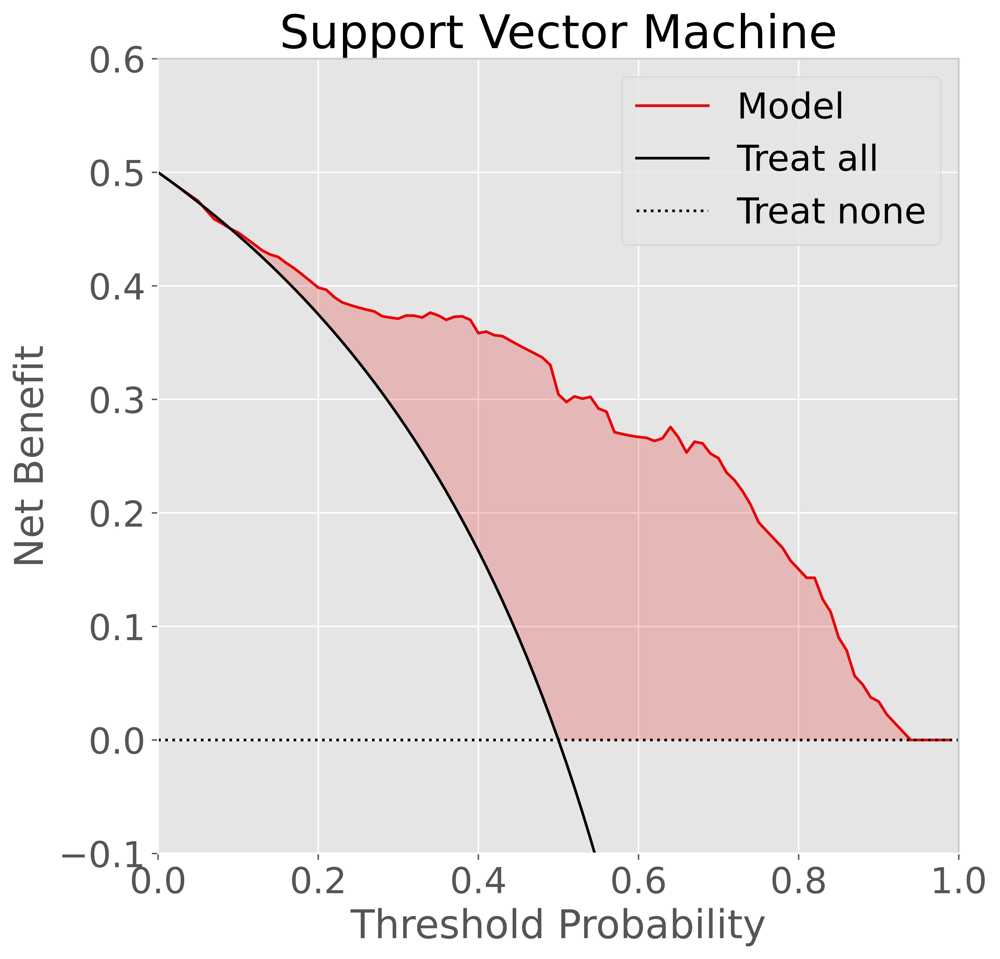

<Figure size 7200x2400 with 0 Axes>

In [287]:
thresh_group = np.arange(0,1,0.01)
net_benefit_model = calculate_net_benefit_model(thresh_group, pred_proba_svc[:,1], y_test)
net_benefit_all = calculate_net_benefit_all(thresh_group, y_test)
fig, ax = plt.subplots()
ax = plot_DCA(ax, thresh_group, net_benefit_model, net_benefit_all)
# fig.savefig('fig1.png', dpi = 300)
plt.title("Support Vector Machine")
#plt.figure(figsize=(10, 10), dpi=600)
plt.figure(dpi=300,figsize=(24,8))
plt.show()